# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
# Check that the device of get_one_hot_labels matches the input device
if torch.cuda.is_available():
    assert str(get_one_hot_labels(torch.Tensor([[0]]).long().cuda(), 1).device).startswith("cuda")
    
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]))
if torch.cuda.is_available():
    # Check that it doesn't break with cuda
    cuda_check = combine_vectors(torch.tensor([[1, 2], [3, 4]]).cuda(), torch.tensor([[5, 6], [7, 8]]).cuda())
    assert str(cuda_check.device).startswith("cuda")
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
# Check that the float transformation doesn't happen after the inputs are concatenated
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12)).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    #generator_input_dim = None
    #discriminator_im_chan = None
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Epoch 1, step 500: Generator loss: 2.4055199216604235, discriminator loss: 0.2318692552037537


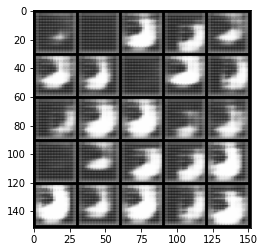

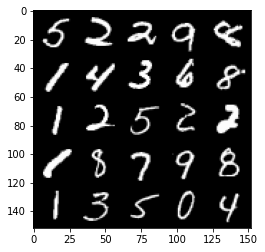

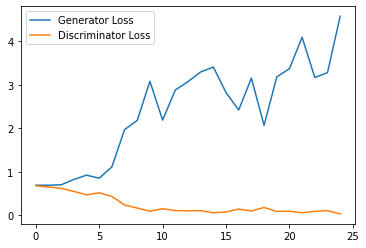

Epoch 2, step 1000: Generator loss: 3.8694464416503904, discriminator loss: 0.05479771196469665


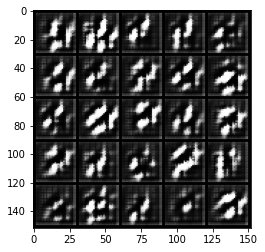

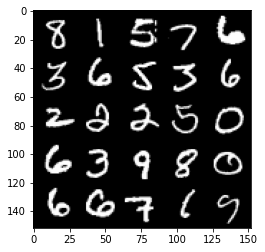

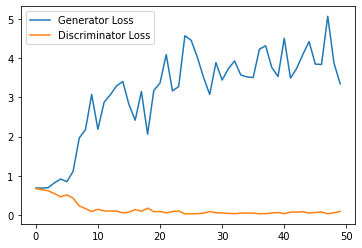

Epoch 3, step 1500: Generator loss: 2.9093233642578125, discriminator loss: 0.18576777210086584


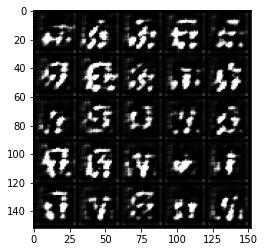

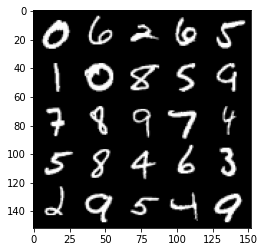

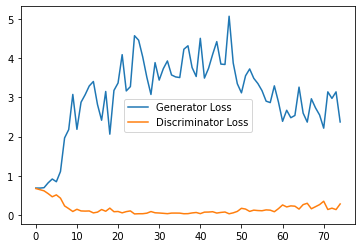

Epoch 4, step 2000: Generator loss: 2.557909769296646, discriminator loss: 0.22286142782866955


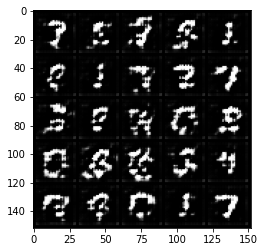

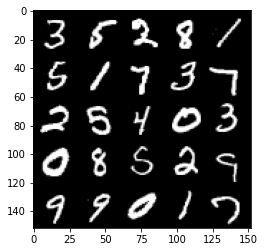

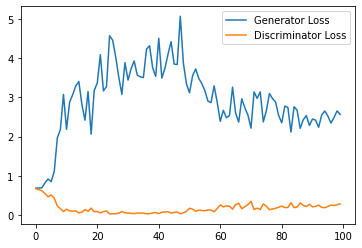

Epoch 5, step 2500: Generator loss: 2.252814385175705, discriminator loss: 0.30095757038891313


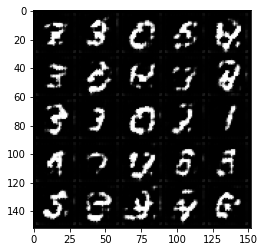

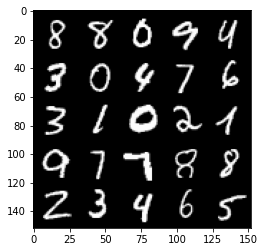

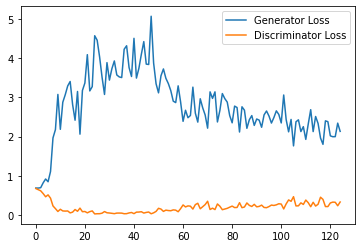

Epoch 6, step 3000: Generator loss: 2.1842054188251496, discriminator loss: 0.3118263636529446


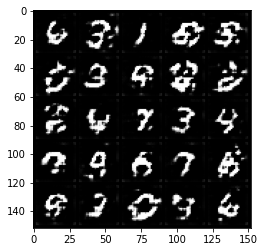

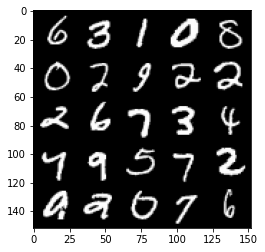

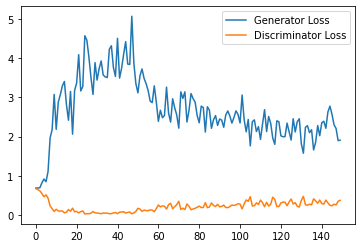

Epoch 7, step 3500: Generator loss: 2.076753167629242, discriminator loss: 0.3049812164604664


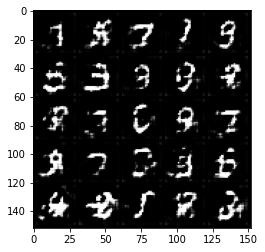

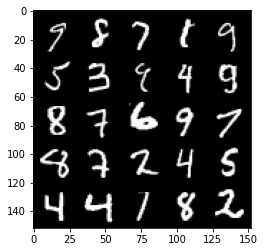

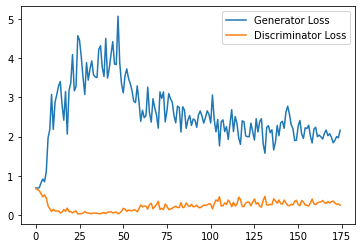

Epoch 8, step 4000: Generator loss: 2.068143003940582, discriminator loss: 0.3376472817659378


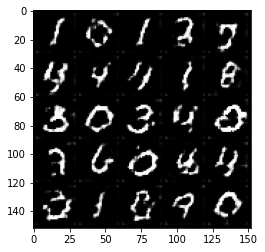

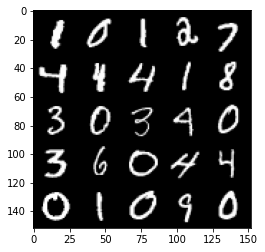

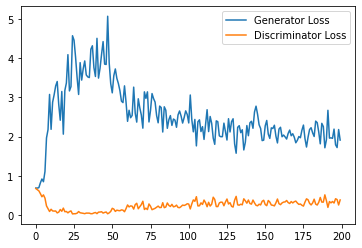

Epoch 9, step 4500: Generator loss: 1.827111121892929, discriminator loss: 0.36750570544600486


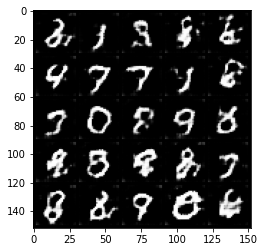

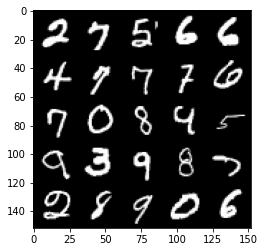

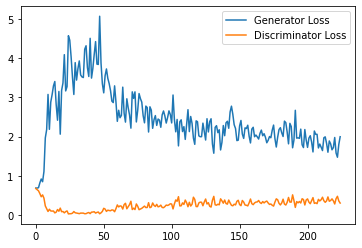

Epoch 10, step 5000: Generator loss: 1.7494821563959122, discriminator loss: 0.38552281114459036


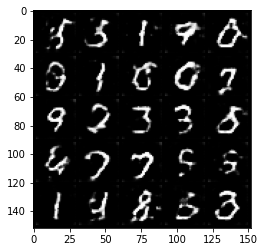

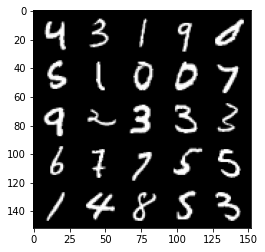

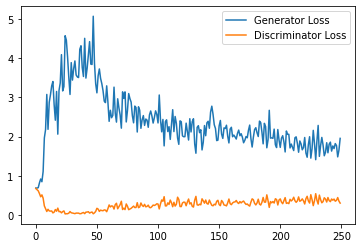

Epoch 11, step 5500: Generator loss: 1.7098044105768204, discriminator loss: 0.4206963782906532


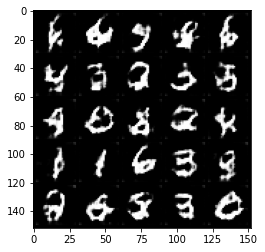

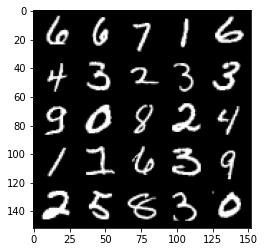

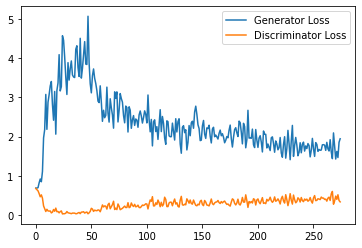

Epoch 12, step 6000: Generator loss: 1.610119183897972, discriminator loss: 0.41424965372681616


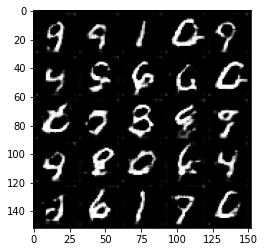

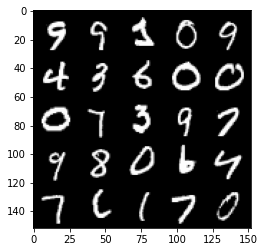

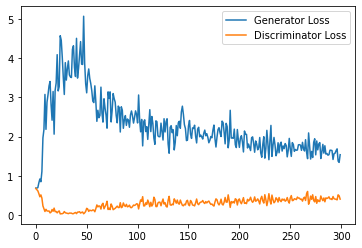

Epoch 13, step 6500: Generator loss: 1.4921997971534728, discriminator loss: 0.4477931253314018


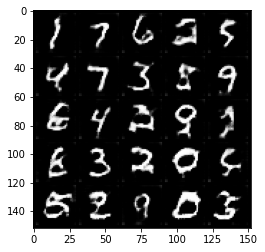

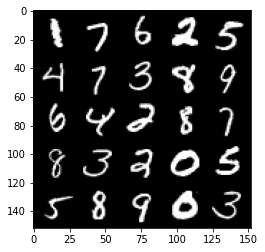

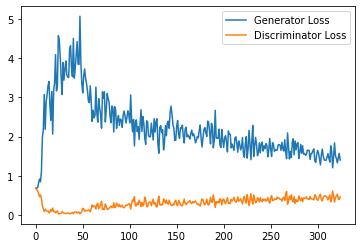

Epoch 14, step 7000: Generator loss: 1.3684207291603088, discriminator loss: 0.47671016061306


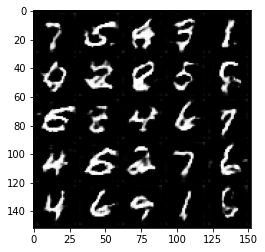

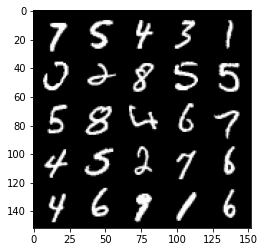

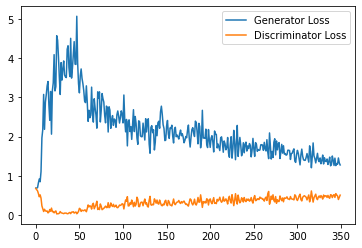

Epoch 15, step 7500: Generator loss: 1.3865201857089997, discriminator loss: 0.5057326543331147


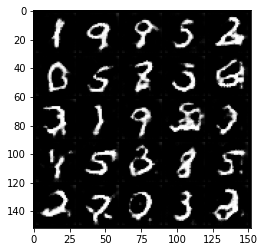

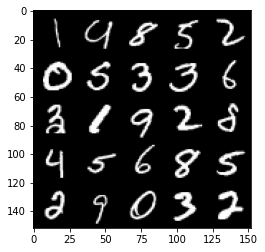

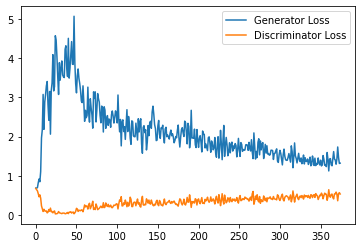

Epoch 17, step 8000: Generator loss: 1.4119645186662675, discriminator loss: 0.5044368863105774


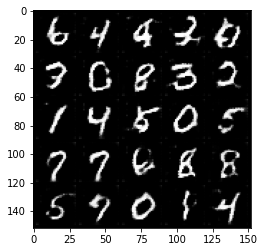

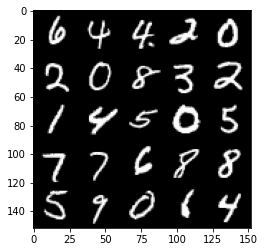

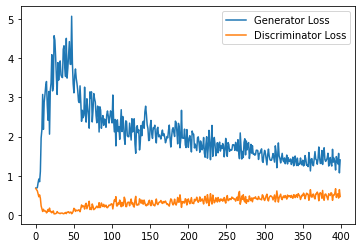

Epoch 18, step 8500: Generator loss: 1.3090403963327408, discriminator loss: 0.5144484651088714


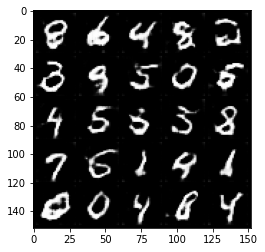

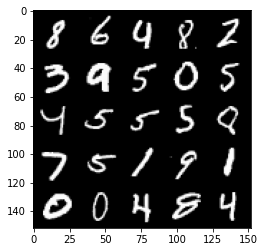

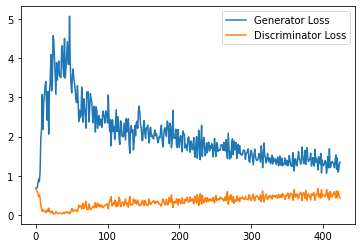

Epoch 19, step 9000: Generator loss: 1.2607948745489121, discriminator loss: 0.5068973203897477


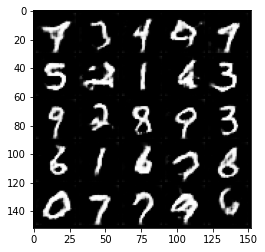

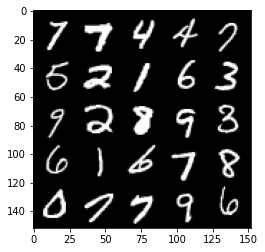

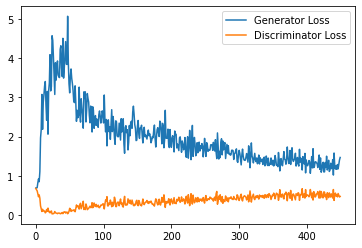

Epoch 20, step 9500: Generator loss: 1.2670550475120543, discriminator loss: 0.5177335702776908


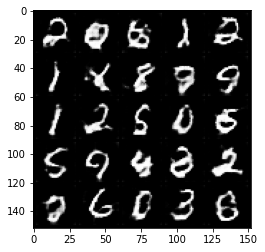

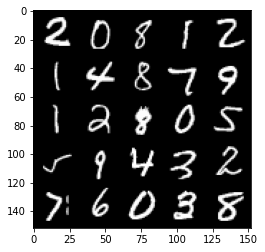

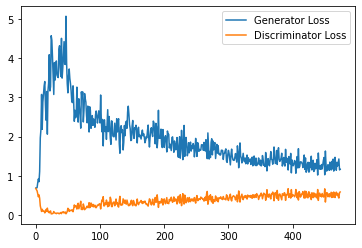

Epoch 21, step 10000: Generator loss: 1.2661042395830155, discriminator loss: 0.5227877153754235


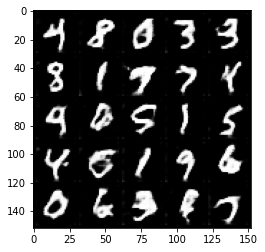

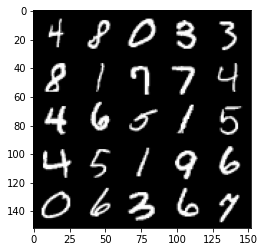

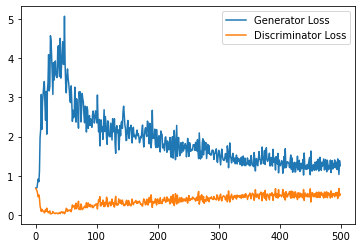

Epoch 22, step 10500: Generator loss: 1.2794442830085755, discriminator loss: 0.529577040374279


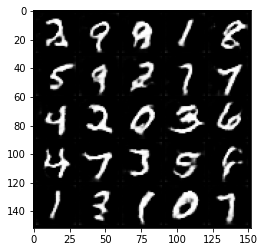

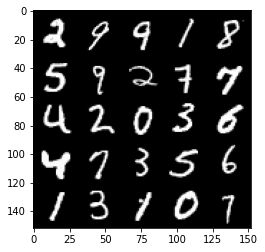

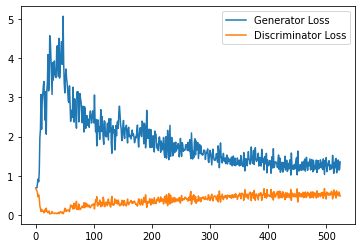

Epoch 23, step 11000: Generator loss: 1.1931395188570022, discriminator loss: 0.5331392375230789


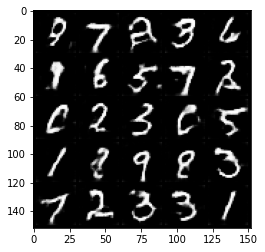

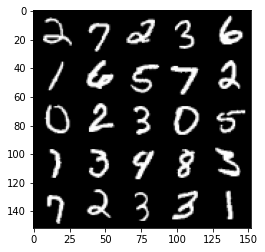

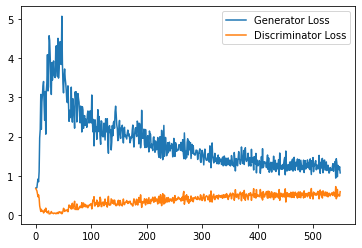

Epoch 24, step 11500: Generator loss: 1.239002520442009, discriminator loss: 0.5294865149855613


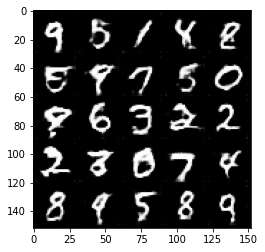

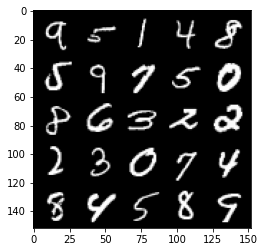

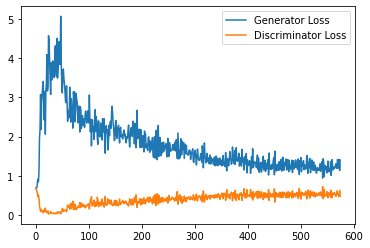

Epoch 25, step 12000: Generator loss: 1.2090180699825286, discriminator loss: 0.544191639304161


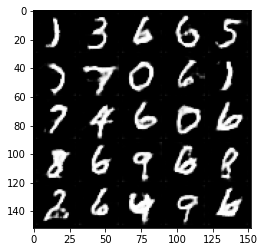

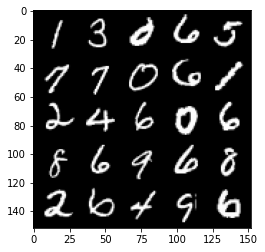

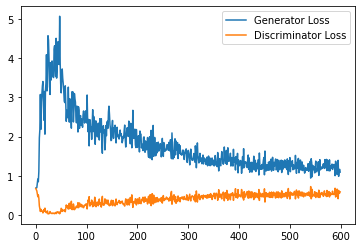

Epoch 26, step 12500: Generator loss: 1.1742764862775803, discriminator loss: 0.5367730756998063


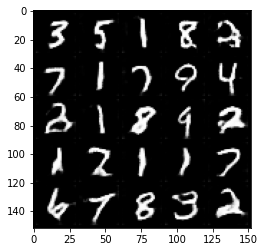

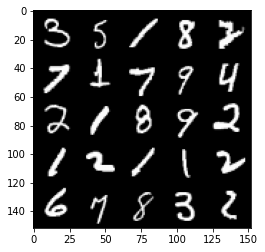

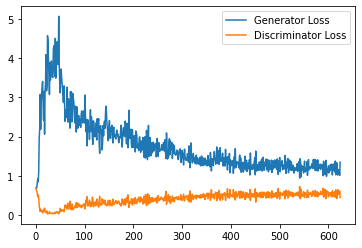

Epoch 27, step 13000: Generator loss: 1.1838370096683501, discriminator loss: 0.539678888142109


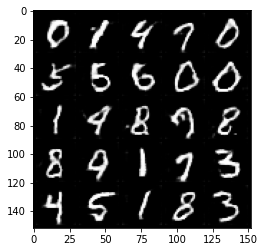

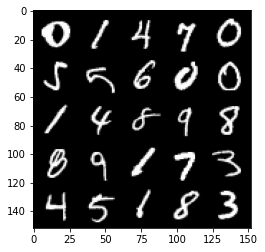

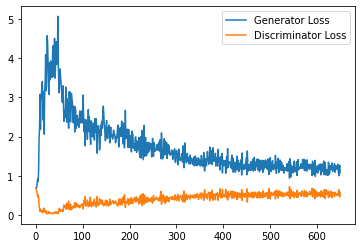

Epoch 28, step 13500: Generator loss: 1.167494693994522, discriminator loss: 0.5480527456998825


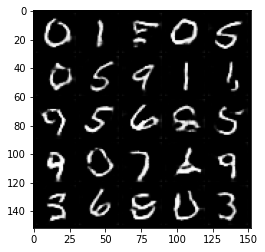

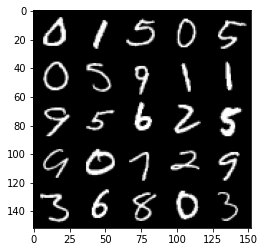

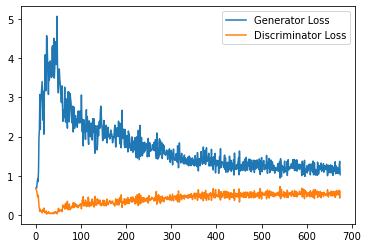

Epoch 29, step 14000: Generator loss: 1.123162385225296, discriminator loss: 0.5498121268749238


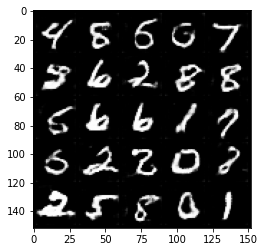

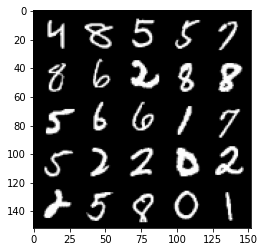

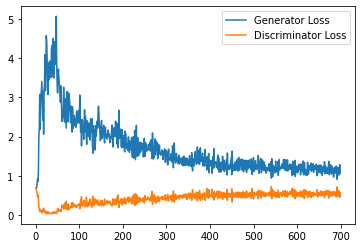

Epoch 30, step 14500: Generator loss: 1.1508499908447265, discriminator loss: 0.5490108712911606


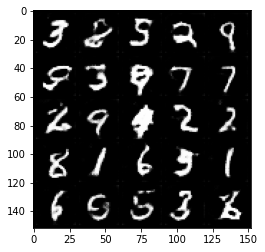

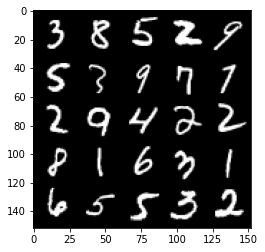

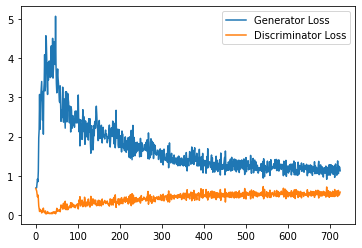

Epoch 31, step 15000: Generator loss: 1.1317478624582291, discriminator loss: 0.5491169778704643


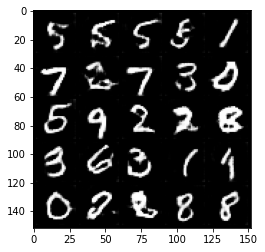

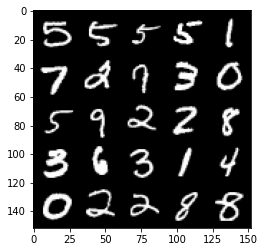

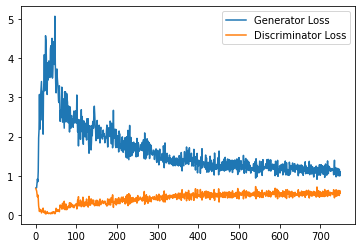

Epoch 33, step 15500: Generator loss: 1.1301865656375885, discriminator loss: 0.5465761573314667


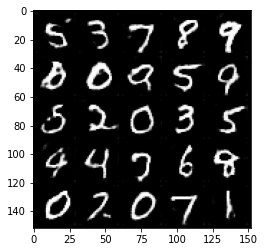

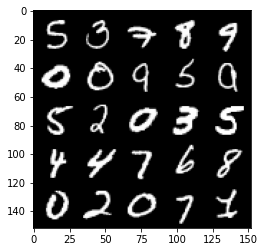

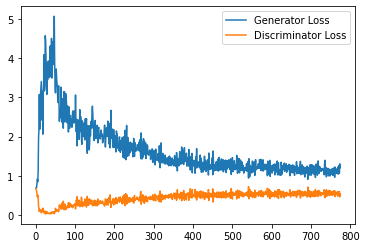

Epoch 34, step 16000: Generator loss: 1.1351770844459534, discriminator loss: 0.5529646038413047


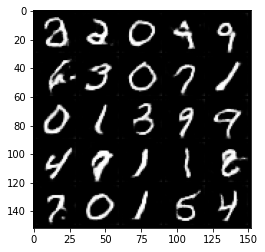

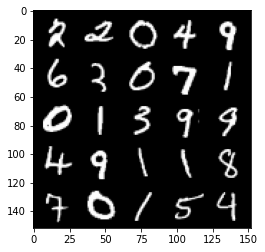

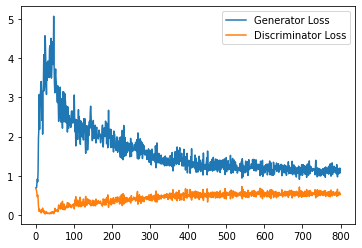

Epoch 35, step 16500: Generator loss: 1.1216775102615357, discriminator loss: 0.5495266813635826


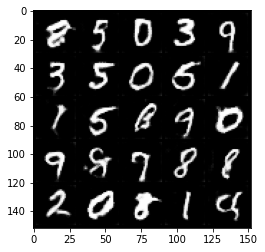

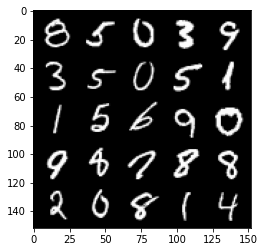

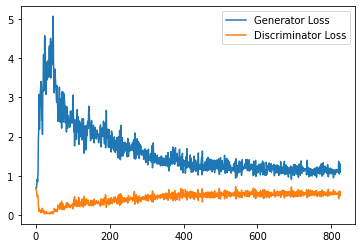

Epoch 36, step 17000: Generator loss: 1.129022290110588, discriminator loss: 0.5568270813822747


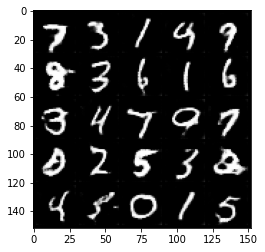

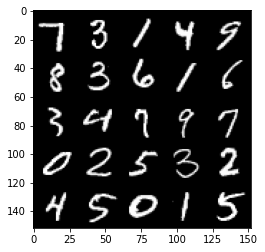

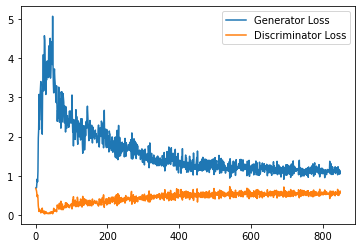

Epoch 37, step 17500: Generator loss: 1.1317149925231933, discriminator loss: 0.5440195218324662


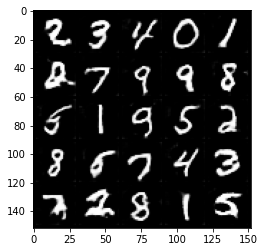

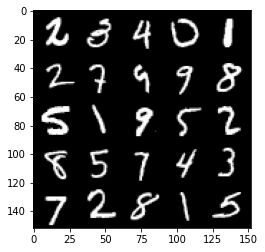

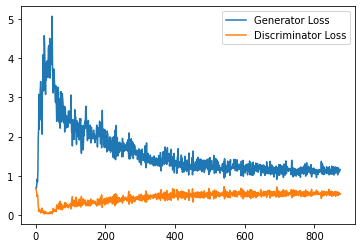

Epoch 38, step 18000: Generator loss: 1.1052031106948852, discriminator loss: 0.5562267187237739


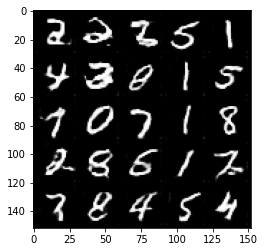

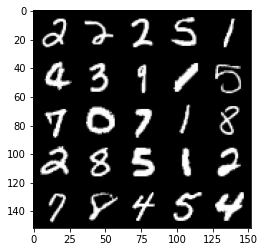

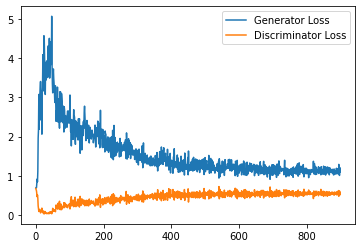

Epoch 39, step 18500: Generator loss: 1.09715840280056, discriminator loss: 0.5567031897306443


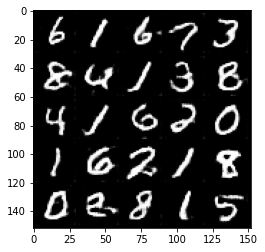

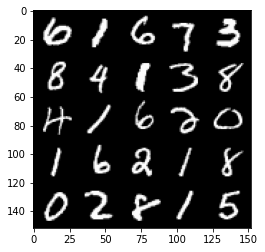

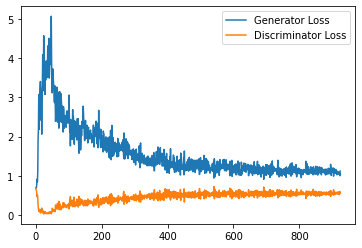

Epoch 40, step 19000: Generator loss: 1.1076043710708618, discriminator loss: 0.5619097836017609


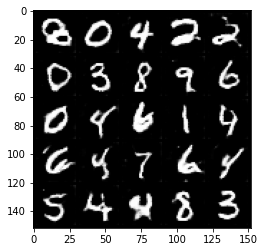

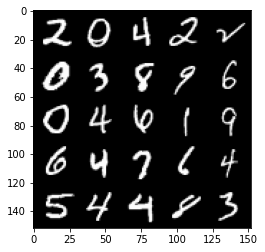

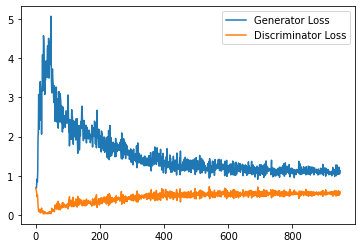

Epoch 41, step 19500: Generator loss: 1.1104967094659806, discriminator loss: 0.5602015919089317


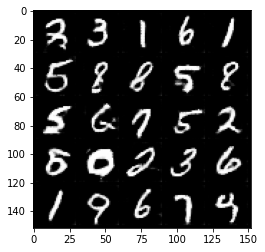

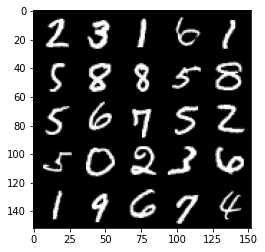

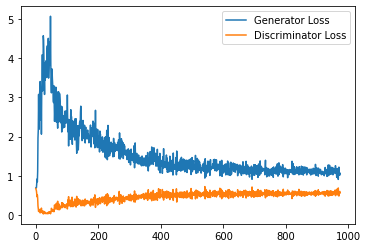

Epoch 42, step 20000: Generator loss: 1.1066284003257751, discriminator loss: 0.5644078465104103


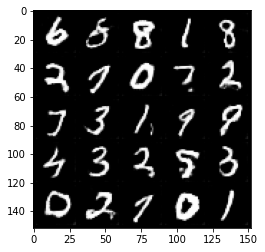

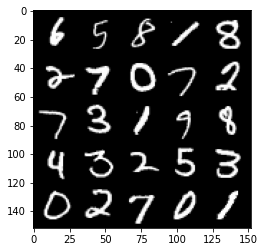

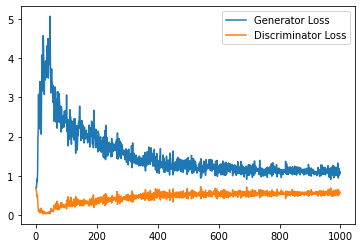

Epoch 43, step 20500: Generator loss: 1.094781709432602, discriminator loss: 0.562763624548912


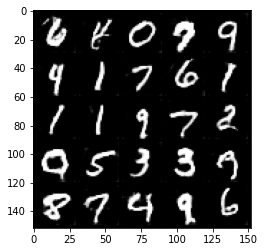

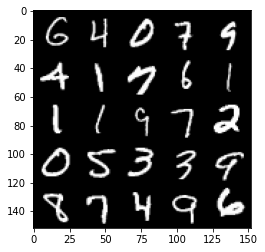

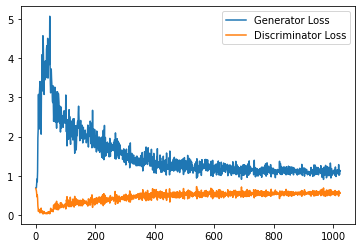

Epoch 44, step 21000: Generator loss: 1.1009235149621963, discriminator loss: 0.5667109488844871


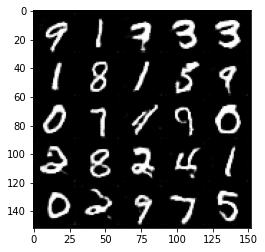

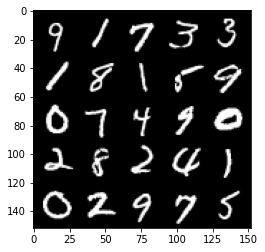

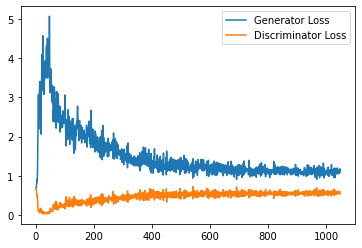

Epoch 45, step 21500: Generator loss: 1.057181056022644, discriminator loss: 0.5704260596632957


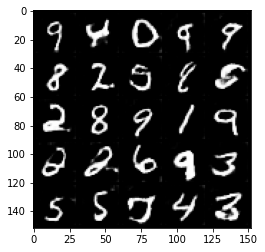

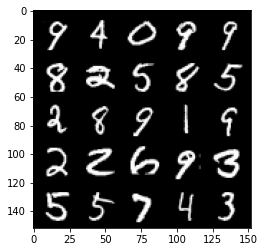

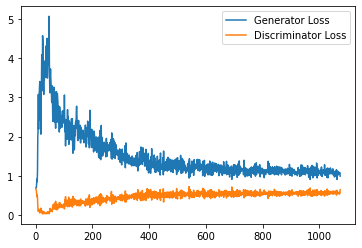

Epoch 46, step 22000: Generator loss: 1.1340450437068939, discriminator loss: 0.560337179005146


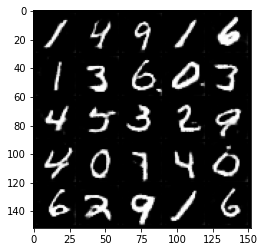

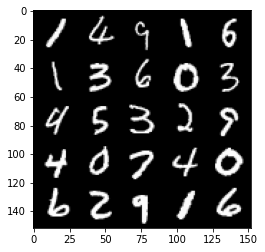

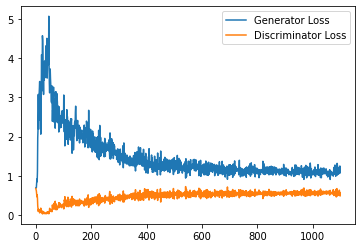

Epoch 47, step 22500: Generator loss: 1.0946559145450592, discriminator loss: 0.5747240445613861


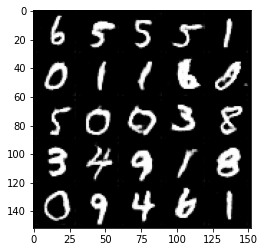

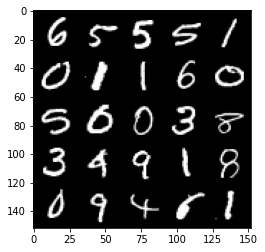

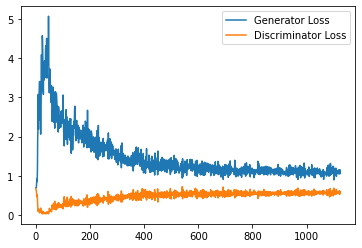

Epoch 49, step 23000: Generator loss: 1.081225111722946, discriminator loss: 0.5725388832688332


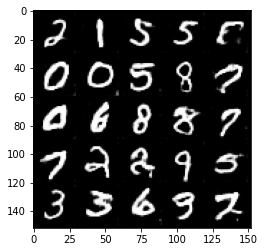

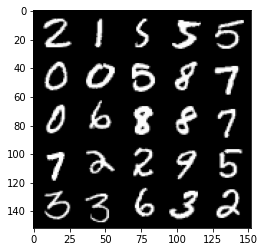

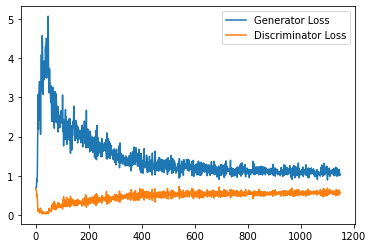

Epoch 50, step 23500: Generator loss: 1.0639099998474122, discriminator loss: 0.5730506863594055


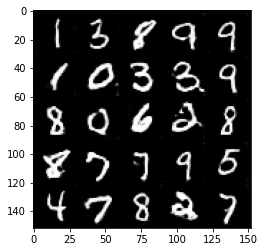

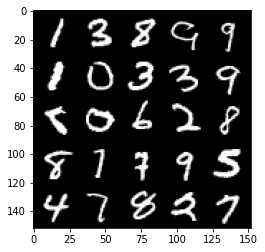

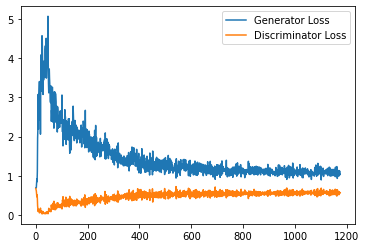

Epoch 51, step 24000: Generator loss: 1.086934407234192, discriminator loss: 0.5734107573628425


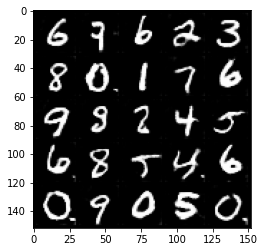

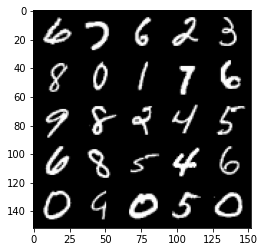

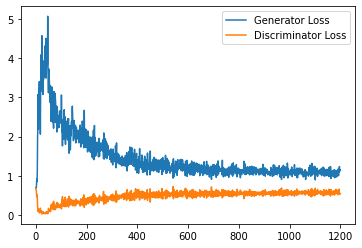

Epoch 52, step 24500: Generator loss: 1.053730760574341, discriminator loss: 0.5801861367821693


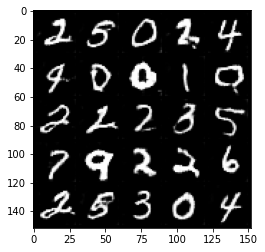

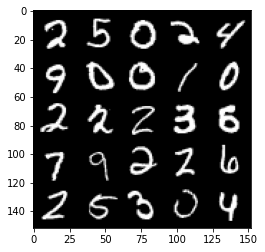

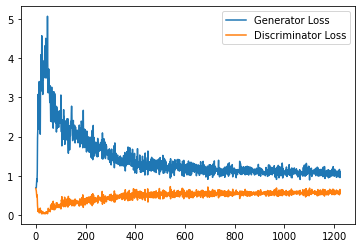

Epoch 53, step 25000: Generator loss: 1.0618643771409988, discriminator loss: 0.5798952273726463


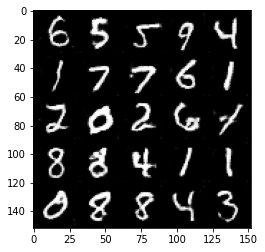

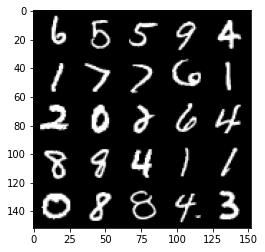

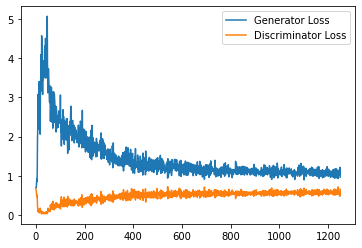

Epoch 54, step 25500: Generator loss: 1.0802366570234299, discriminator loss: 0.5815976254343986


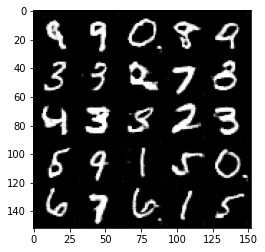

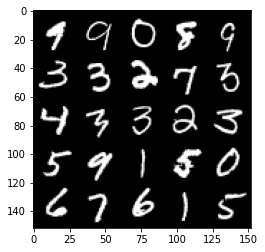

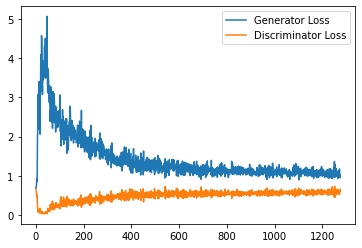

Epoch 55, step 26000: Generator loss: 1.0555572625398635, discriminator loss: 0.5809567468166351


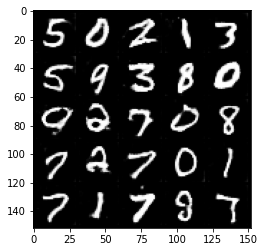

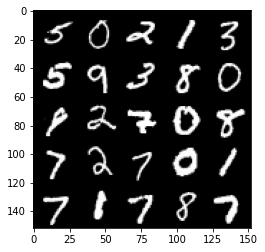

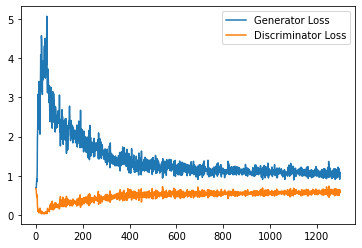

Epoch 56, step 26500: Generator loss: 1.0383231956958772, discriminator loss: 0.5841883555650711


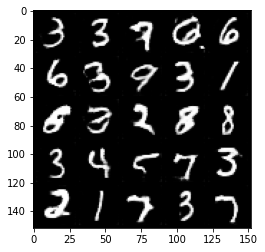

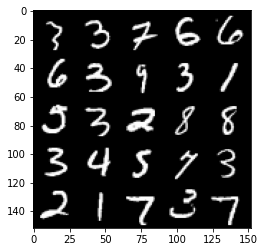

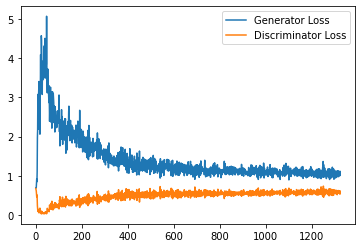

Epoch 57, step 27000: Generator loss: 1.0563876971006394, discriminator loss: 0.5865512469410896


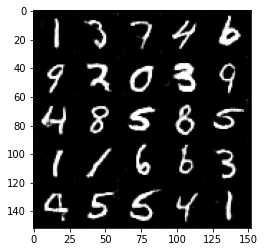

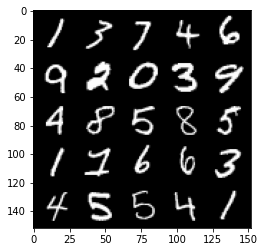

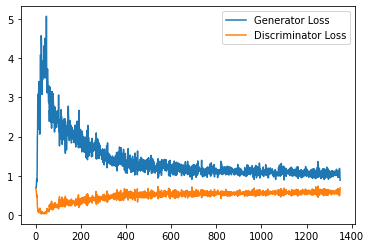

Epoch 58, step 27500: Generator loss: 1.0454921637773513, discriminator loss: 0.5844185754656792


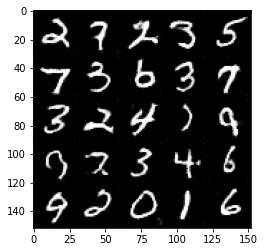

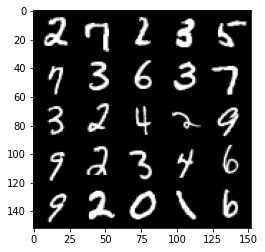

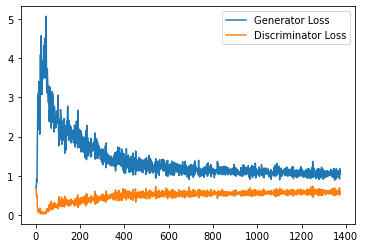

Epoch 59, step 28000: Generator loss: 1.054180603981018, discriminator loss: 0.5838889930844307


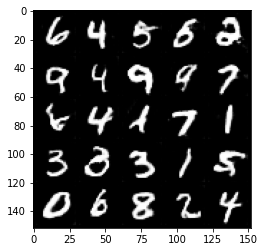

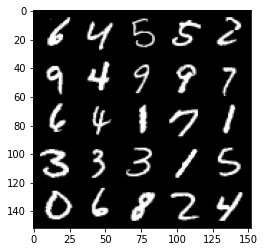

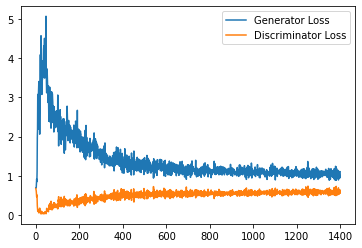

Epoch 60, step 28500: Generator loss: 1.0144112998247146, discriminator loss: 0.5840678476095199


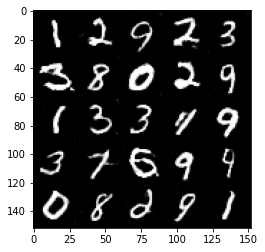

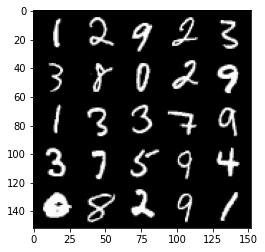

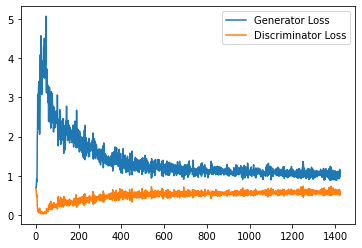

Epoch 61, step 29000: Generator loss: 1.0332474817037582, discriminator loss: 0.5826140255331993


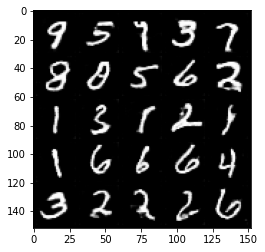

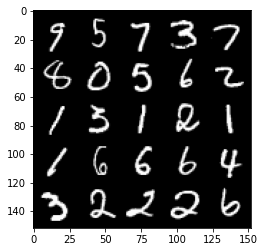

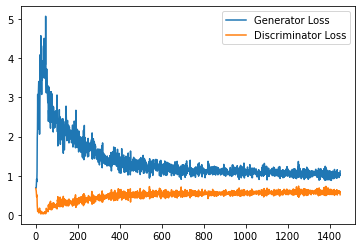

Epoch 62, step 29500: Generator loss: 1.051591493844986, discriminator loss: 0.586966814160347


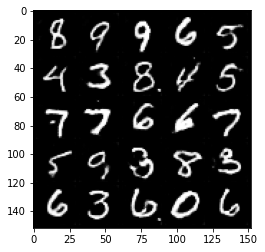

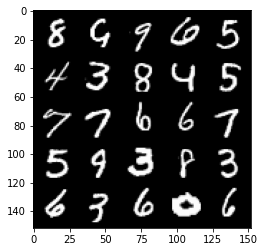

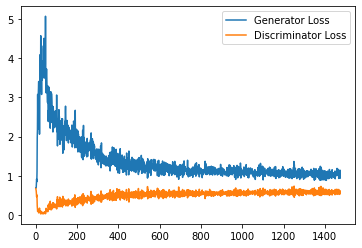

Epoch 63, step 30000: Generator loss: 1.0425097926855087, discriminator loss: 0.5824821085929871


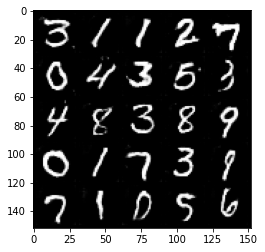

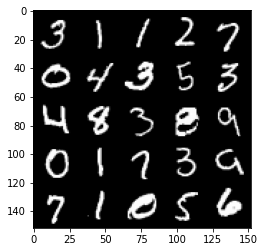

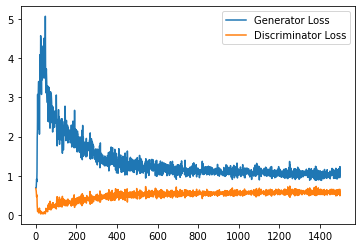

Epoch 65, step 30500: Generator loss: 1.096988427042961, discriminator loss: 0.5841091642379761


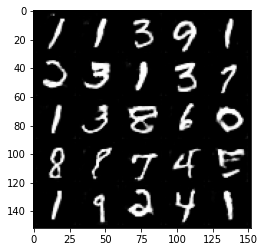

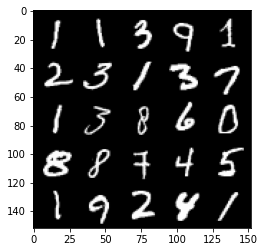

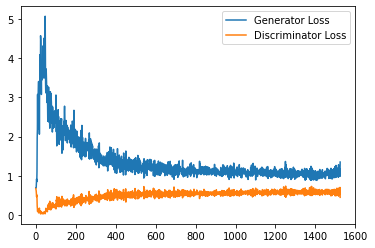

Epoch 66, step 31000: Generator loss: 1.0449949674606323, discriminator loss: 0.5866580266952515


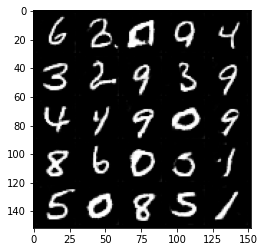

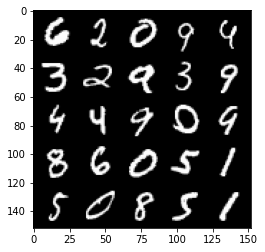

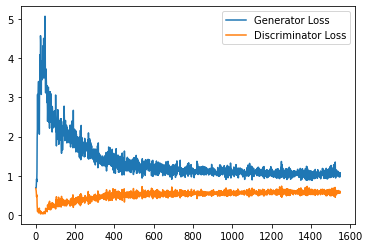

Epoch 67, step 31500: Generator loss: 1.0793692487478257, discriminator loss: 0.5847460107207298


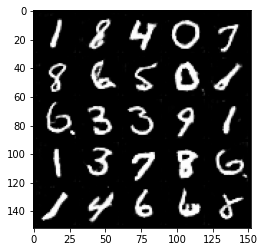

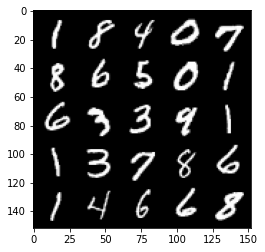

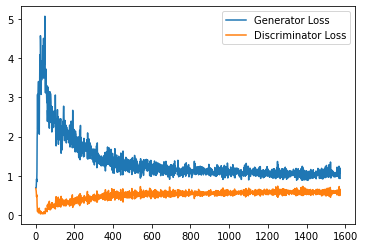

Epoch 68, step 32000: Generator loss: 1.0608663384914399, discriminator loss: 0.57995420140028


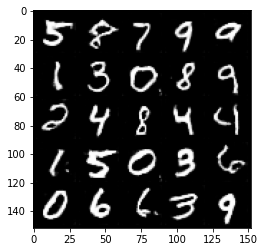

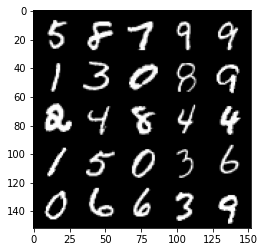

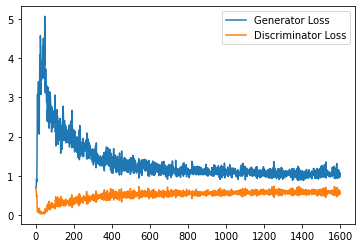

Epoch 69, step 32500: Generator loss: 1.0216690942049027, discriminator loss: 0.5844757471084595


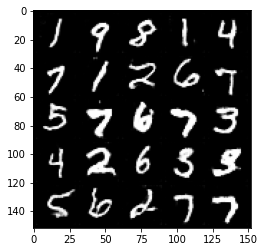

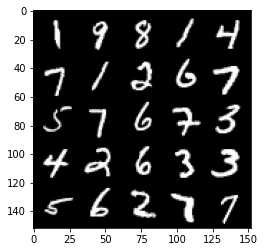

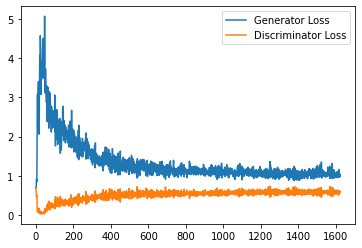

Epoch 70, step 33000: Generator loss: 1.0459033811092378, discriminator loss: 0.5874921070933342


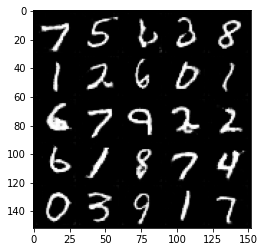

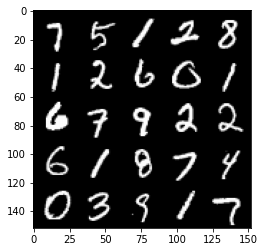

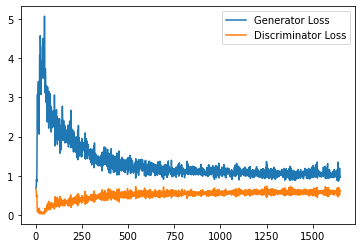

Epoch 71, step 33500: Generator loss: 1.0315581580400468, discriminator loss: 0.5797496517896652


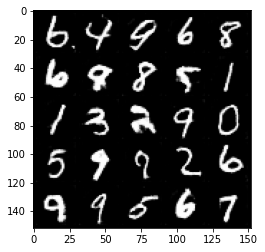

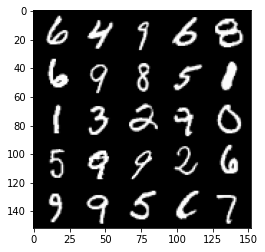

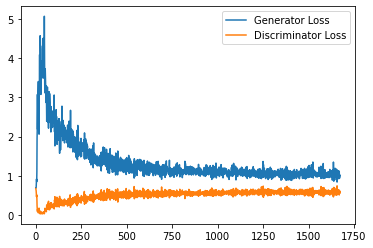

Epoch 72, step 34000: Generator loss: 1.0489164420366288, discriminator loss: 0.5816196404695511


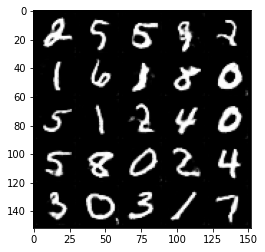

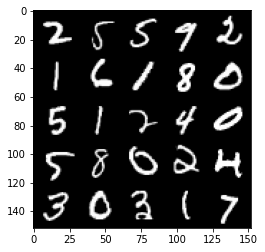

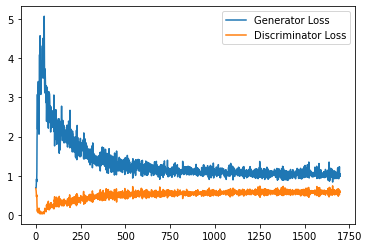

Epoch 73, step 34500: Generator loss: 1.0462410393953323, discriminator loss: 0.5768472660183906


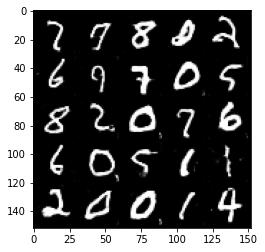

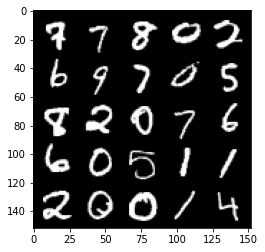

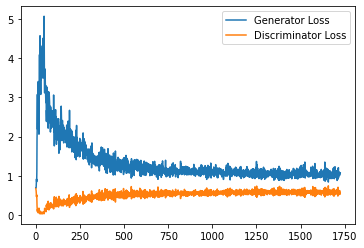

Epoch 74, step 35000: Generator loss: 1.019439000248909, discriminator loss: 0.5803218398690224


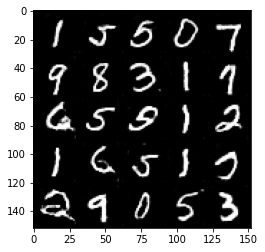

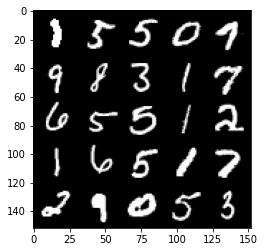

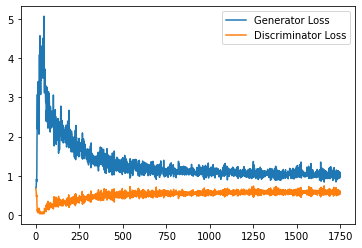

Epoch 75, step 35500: Generator loss: 1.0329399900436402, discriminator loss: 0.579752947986126


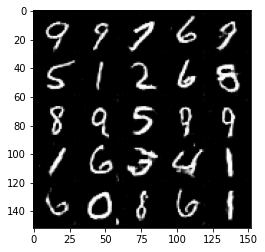

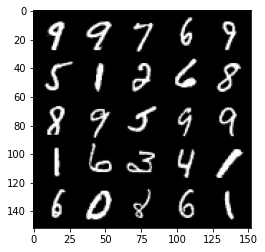

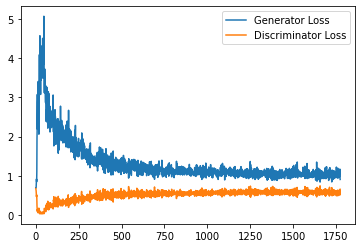

Epoch 76, step 36000: Generator loss: 1.0431461448669435, discriminator loss: 0.5800858547091484


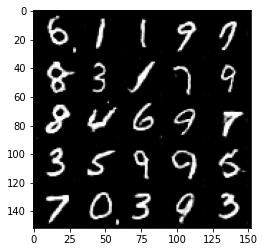

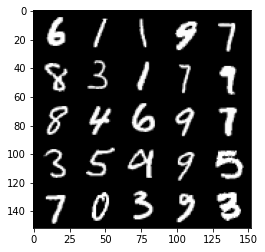

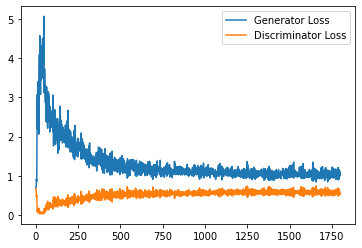

Epoch 77, step 36500: Generator loss: 1.053172912955284, discriminator loss: 0.5751526418328285


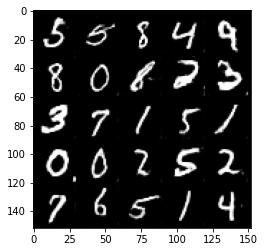

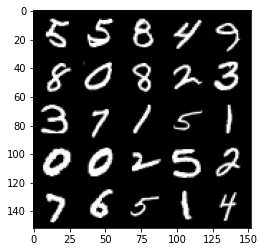

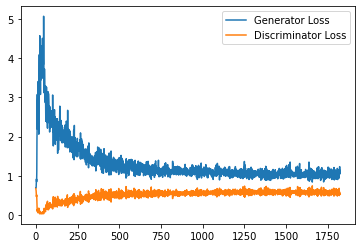

Epoch 78, step 37000: Generator loss: 1.0311162576675414, discriminator loss: 0.5841857342720032


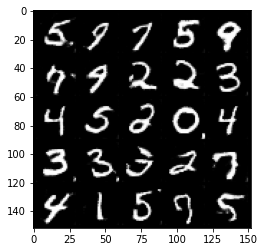

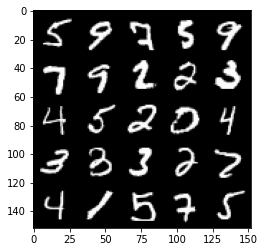

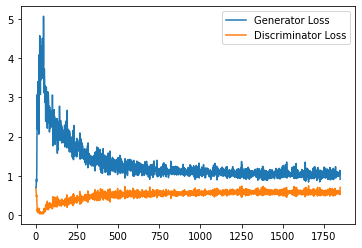

Epoch 79, step 37500: Generator loss: 1.0715124969482421, discriminator loss: 0.5779886794090271


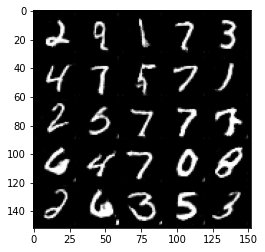

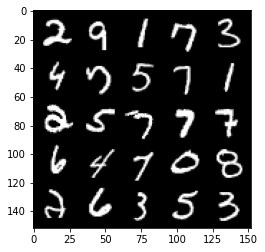

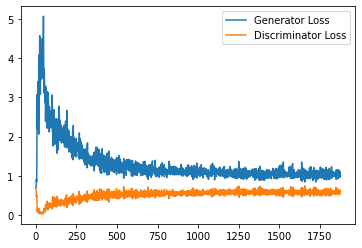

Epoch 81, step 38000: Generator loss: 1.0766666061878205, discriminator loss: 0.5822491536736488


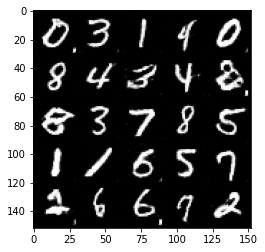

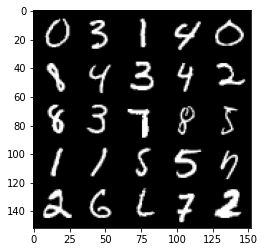

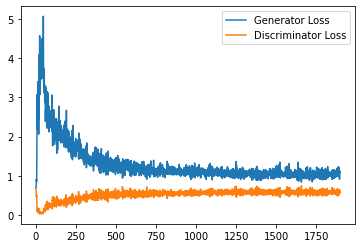

Epoch 82, step 38500: Generator loss: 1.0389491086006164, discriminator loss: 0.5849406387805939


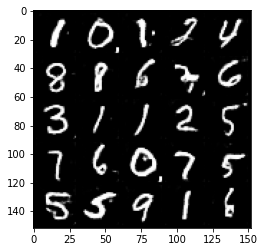

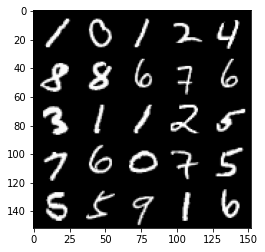

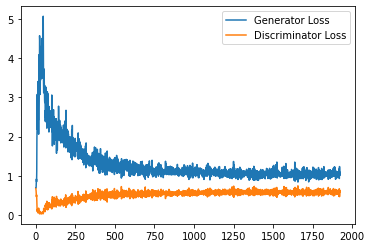

Epoch 83, step 39000: Generator loss: 1.0501788371801377, discriminator loss: 0.5791132691502571


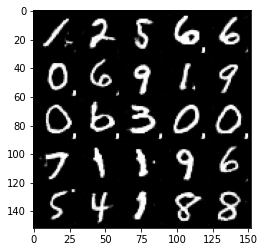

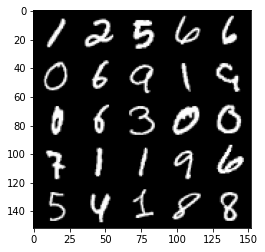

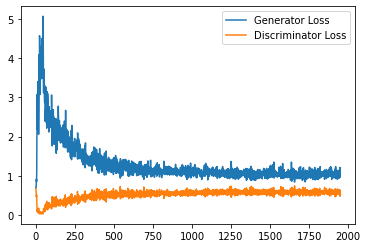

Epoch 84, step 39500: Generator loss: 1.0448559502363204, discriminator loss: 0.578525875389576


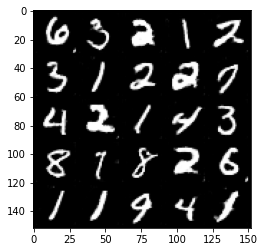

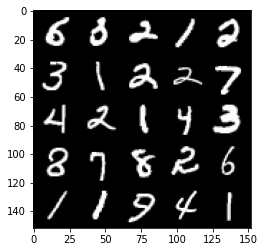

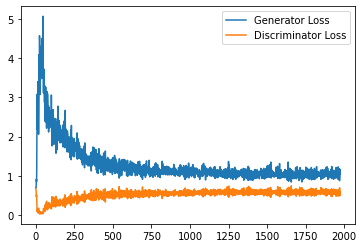

Epoch 85, step 40000: Generator loss: 1.0637059297561646, discriminator loss: 0.5772156004309654


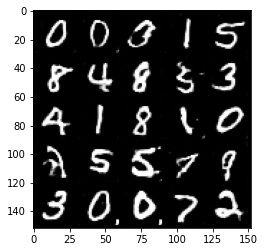

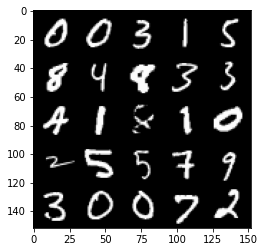

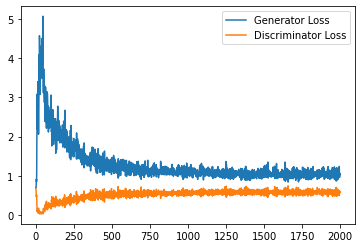

Epoch 86, step 40500: Generator loss: 1.0491344075202942, discriminator loss: 0.5767960009574891


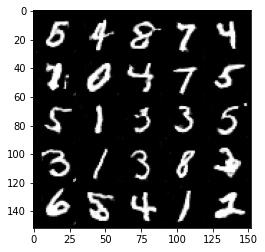

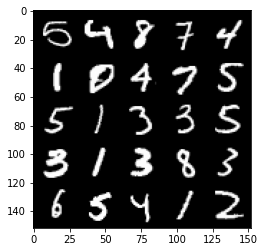

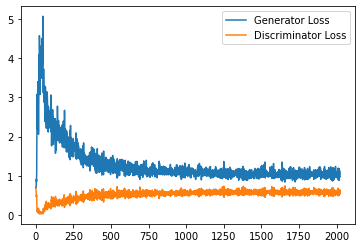

Epoch 87, step 41000: Generator loss: 1.0582175083160401, discriminator loss: 0.5699446257948876


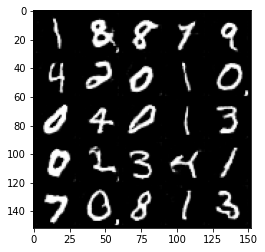

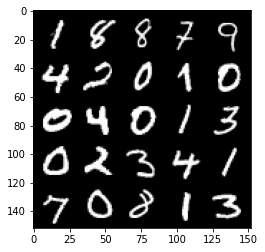

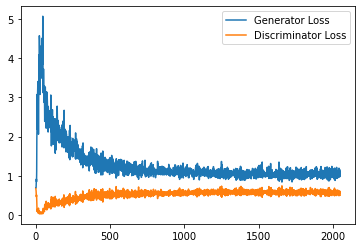

Epoch 88, step 41500: Generator loss: 1.0447918537855148, discriminator loss: 0.575578390955925


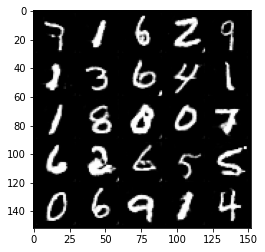

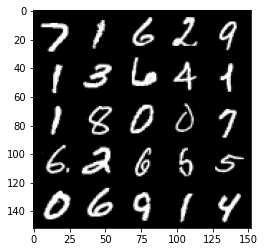

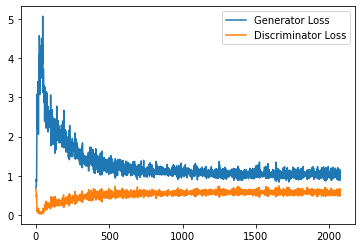

Epoch 89, step 42000: Generator loss: 1.0752519067525863, discriminator loss: 0.5725008179545402


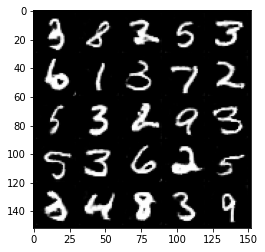

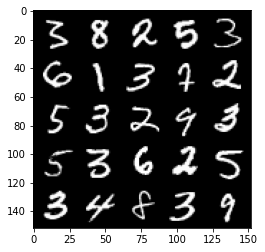

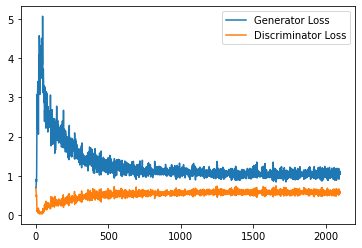

Epoch 90, step 42500: Generator loss: 1.0753921020030974, discriminator loss: 0.5740764154195785


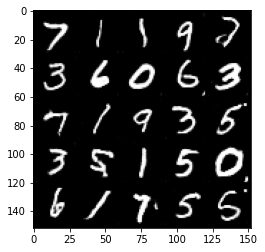

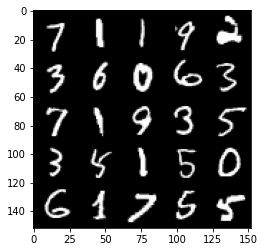

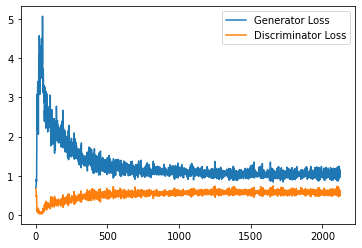

Epoch 91, step 43000: Generator loss: 1.061055523633957, discriminator loss: 0.5691687215566635


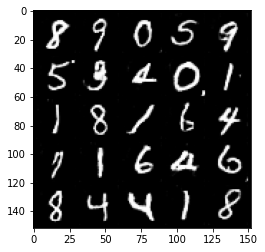

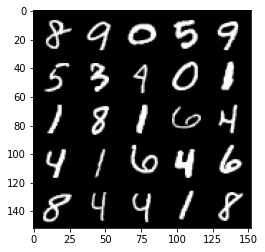

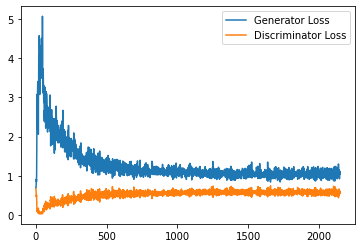

Epoch 92, step 43500: Generator loss: 1.0586196454763412, discriminator loss: 0.5699301298856735


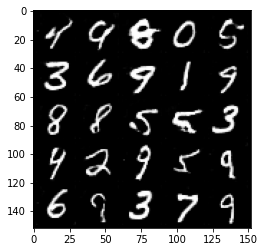

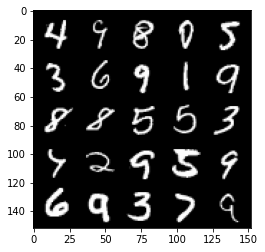

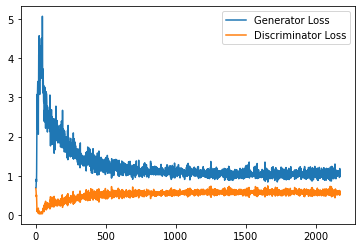

Epoch 93, step 44000: Generator loss: 1.0659682170152665, discriminator loss: 0.5746778814792634


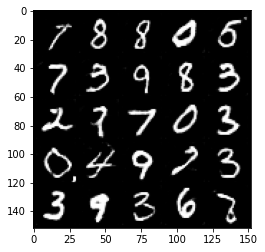

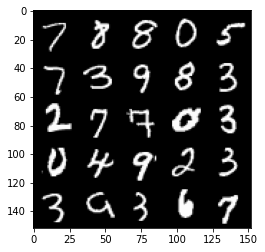

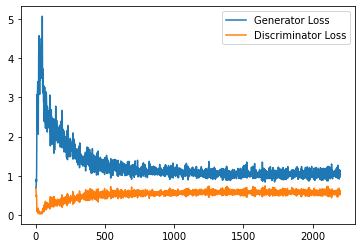

Epoch 94, step 44500: Generator loss: 1.0546860610246658, discriminator loss: 0.5677477865219116


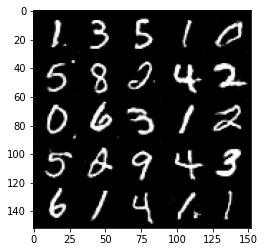

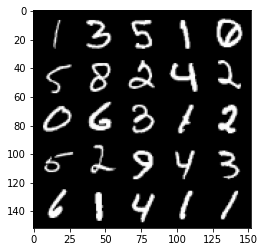

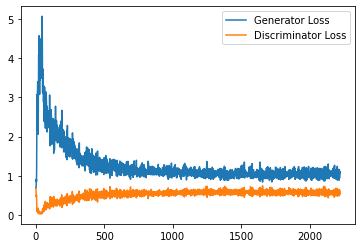

Epoch 95, step 45000: Generator loss: 1.0817792332172393, discriminator loss: 0.5656186097860336


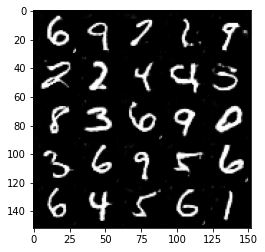

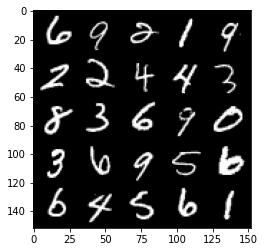

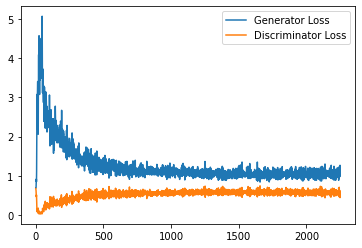

Epoch 97, step 45500: Generator loss: 1.068423122048378, discriminator loss: 0.5705259385108947


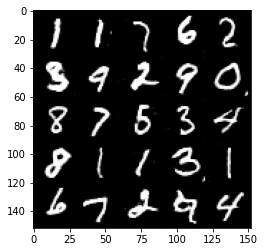

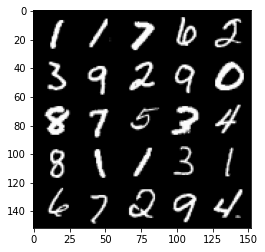

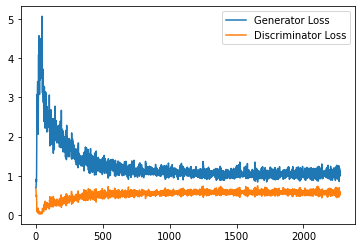

Epoch 98, step 46000: Generator loss: 1.09374438226223, discriminator loss: 0.5649261506795883


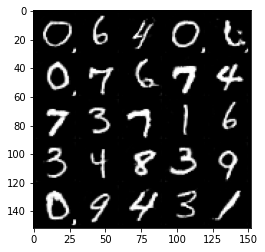

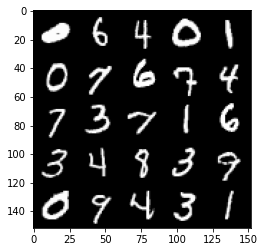

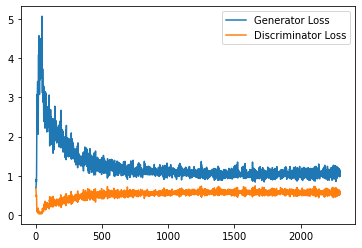

Epoch 99, step 46500: Generator loss: 1.0840901594161987, discriminator loss: 0.5613362233042717


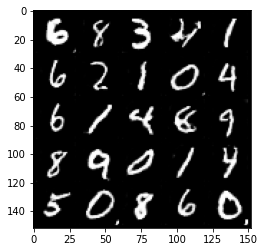

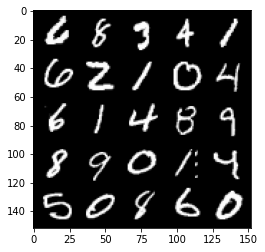

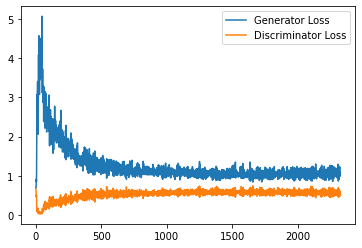

Epoch 100, step 47000: Generator loss: 1.0847544366121291, discriminator loss: 0.5692935878038407


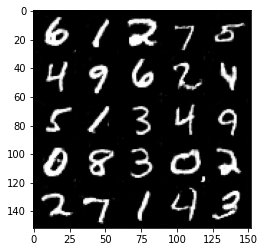

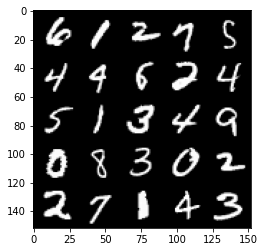

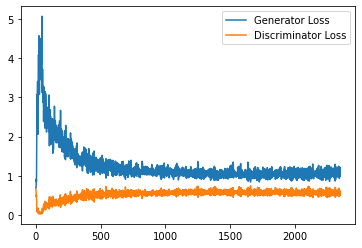

Epoch 101, step 47500: Generator loss: 1.0820246512889862, discriminator loss: 0.5682811159491539


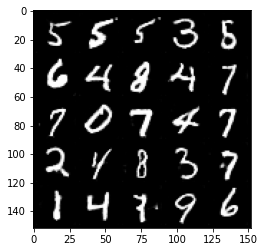

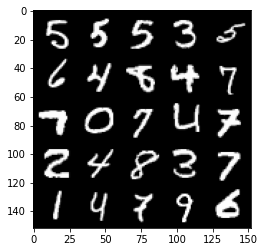

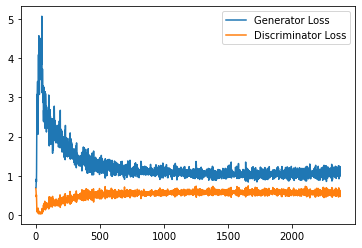

Epoch 102, step 48000: Generator loss: 1.0925815278291702, discriminator loss: 0.5596976928710937


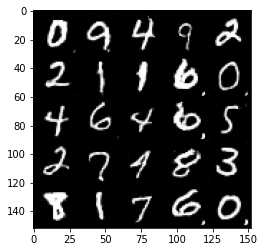

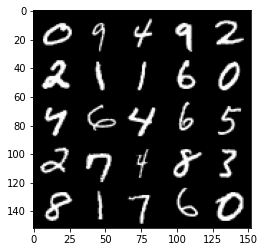

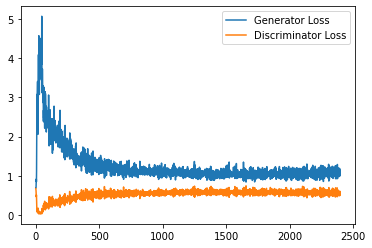

Epoch 103, step 48500: Generator loss: 1.0886906080245973, discriminator loss: 0.5605768648982048


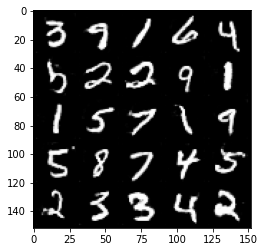

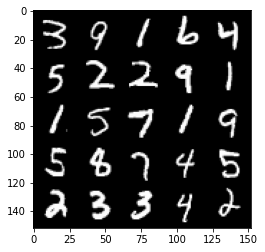

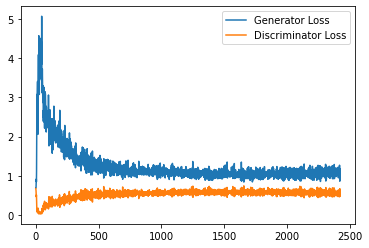

Epoch 104, step 49000: Generator loss: 1.0887291033267974, discriminator loss: 0.560365264415741


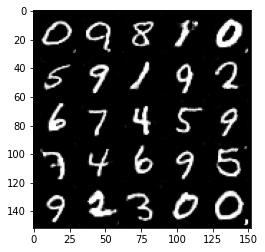

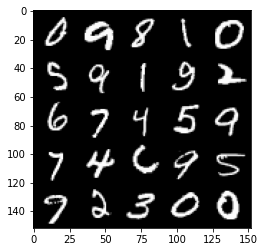

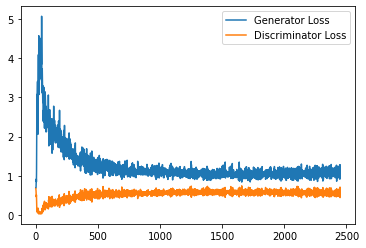

Epoch 105, step 49500: Generator loss: 1.0814981018304826, discriminator loss: 0.5588016996383667


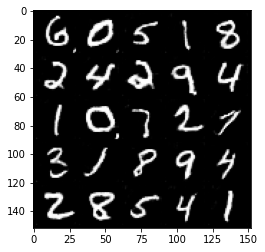

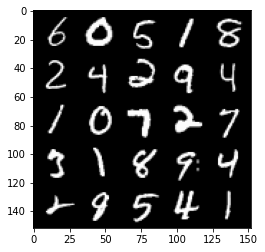

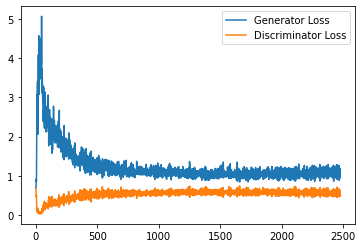

Epoch 106, step 50000: Generator loss: 1.0986622722148895, discriminator loss: 0.5488642252087593


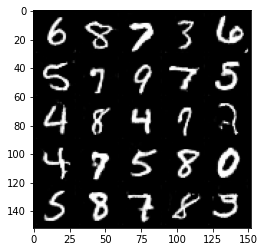

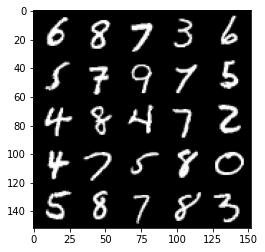

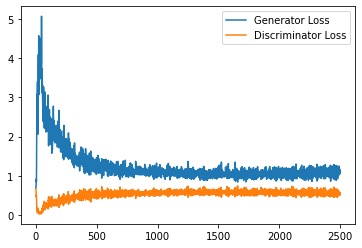

Epoch 107, step 50500: Generator loss: 1.104218877196312, discriminator loss: 0.5591551909446716


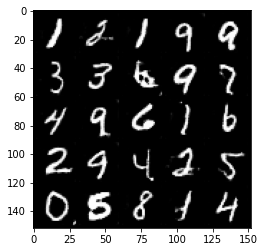

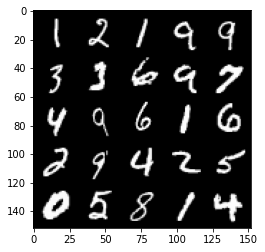

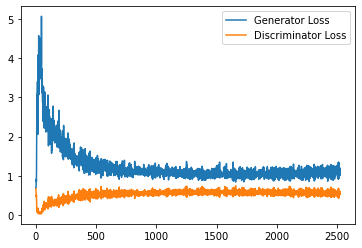

Epoch 108, step 51000: Generator loss: 1.1299545383453369, discriminator loss: 0.553926697075367


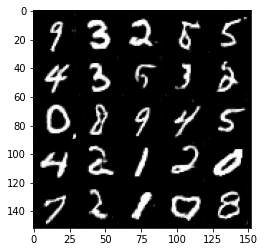

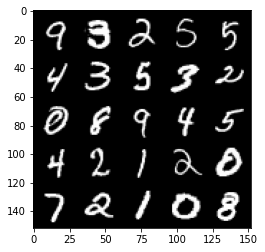

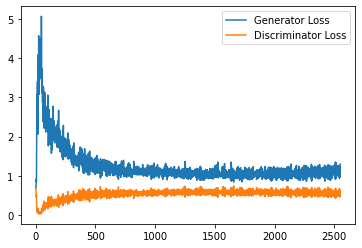

Epoch 109, step 51500: Generator loss: 1.0917584683895112, discriminator loss: 0.5554774881005288


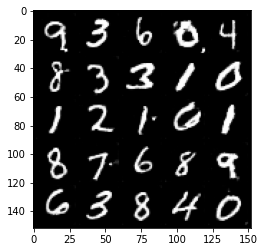

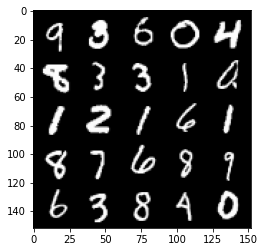

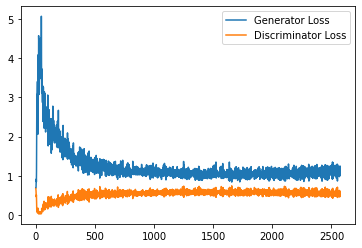

Epoch 110, step 52000: Generator loss: 1.1328801592588424, discriminator loss: 0.5502215583920479


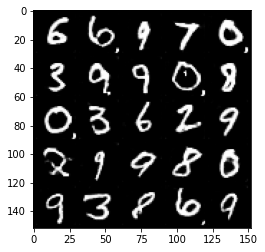

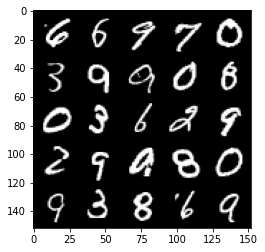

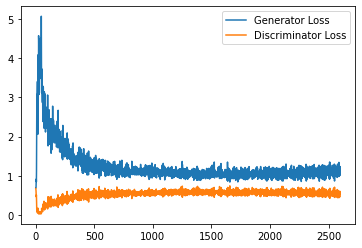

Epoch 111, step 52500: Generator loss: 1.0971851377487183, discriminator loss: 0.5549079205393791


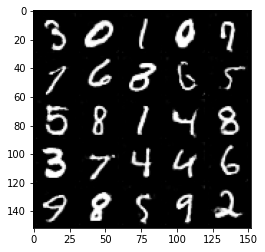

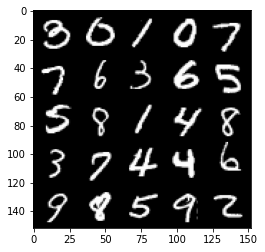

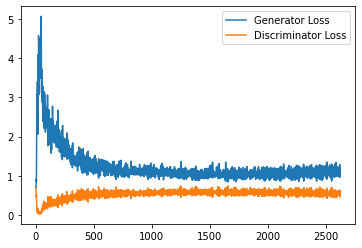

Epoch 113, step 53000: Generator loss: 1.123377738237381, discriminator loss: 0.553917955994606


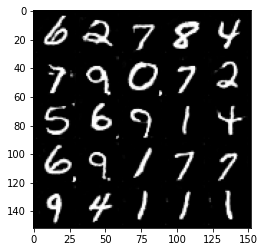

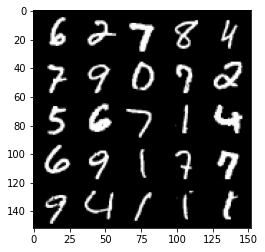

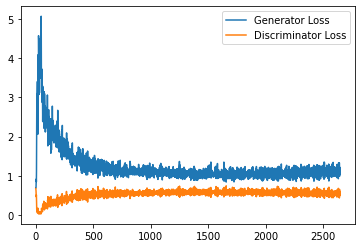

Epoch 114, step 53500: Generator loss: 1.1294227468967437, discriminator loss: 0.5527646909356118


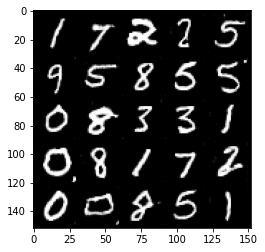

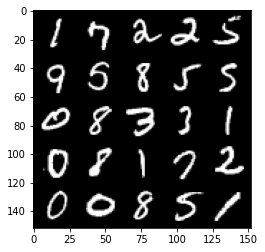

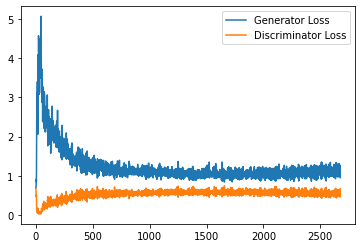

Epoch 115, step 54000: Generator loss: 1.1239832906723022, discriminator loss: 0.5519056960940361


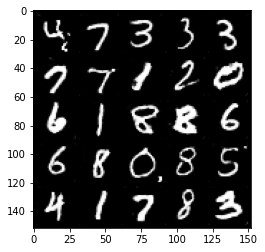

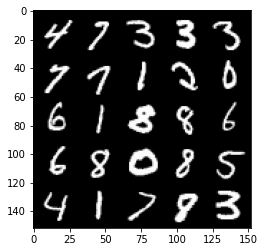

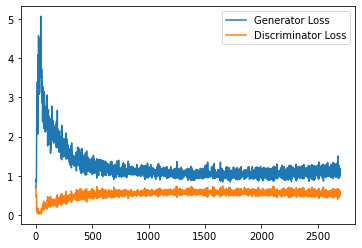

Epoch 116, step 54500: Generator loss: 1.1157290018796922, discriminator loss: 0.5450148115754128


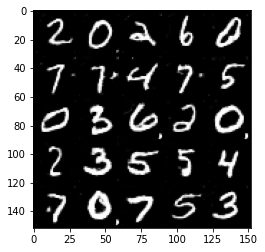

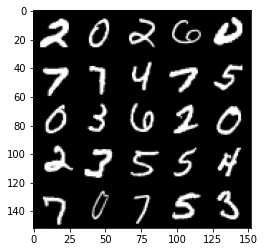

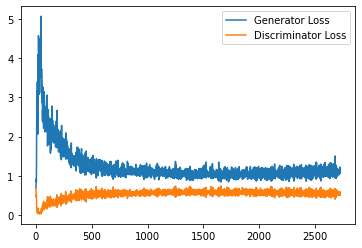

Epoch 117, step 55000: Generator loss: 1.1436806696653365, discriminator loss: 0.5504098962545395


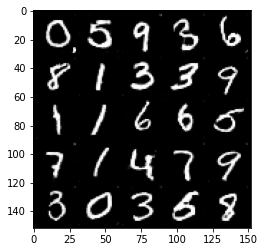

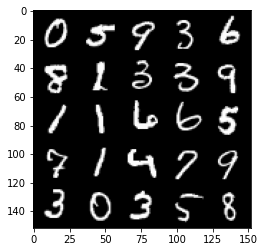

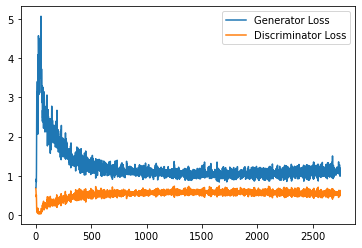

Epoch 118, step 55500: Generator loss: 1.120324532389641, discriminator loss: 0.550427017390728


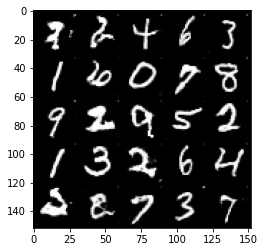

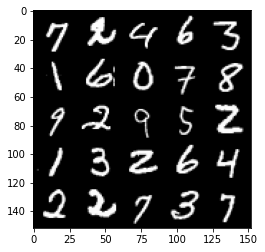

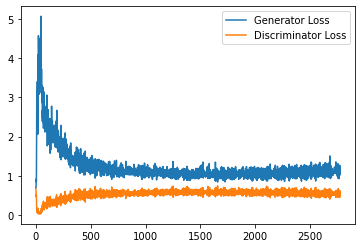

Epoch 119, step 56000: Generator loss: 1.1461759798526765, discriminator loss: 0.5478365389704705


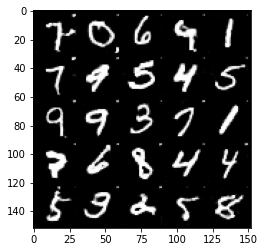

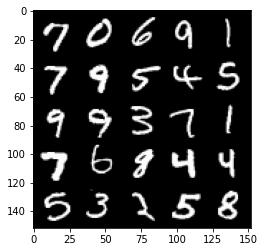

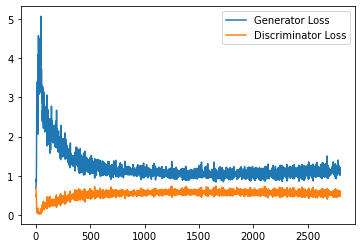

Epoch 120, step 56500: Generator loss: 1.1103233828544616, discriminator loss: 0.5482185187339783


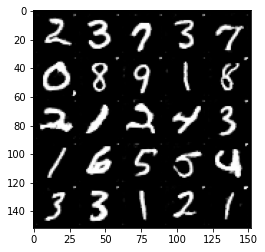

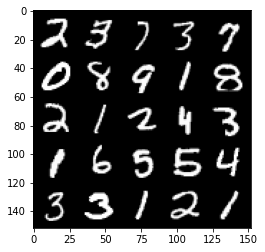

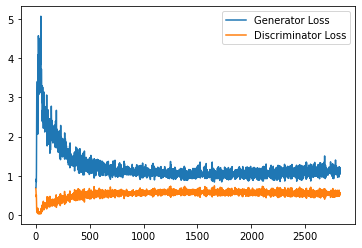

Epoch 121, step 57000: Generator loss: 1.125731031537056, discriminator loss: 0.55200281894207


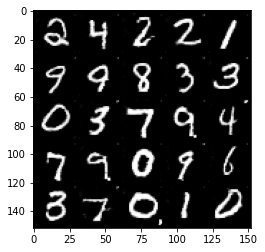

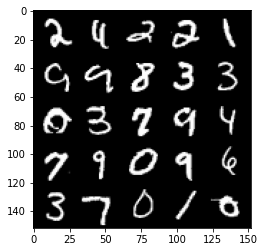

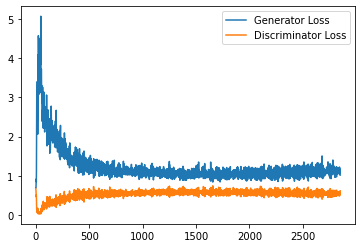

Epoch 122, step 57500: Generator loss: 1.1680125902891159, discriminator loss: 0.539239406466484


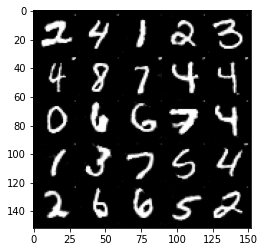

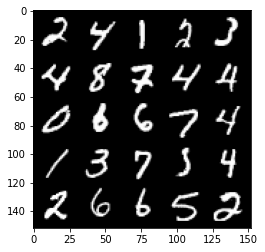

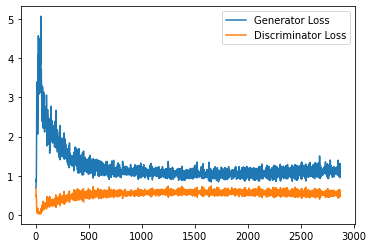

Epoch 123, step 58000: Generator loss: 1.1189657893180847, discriminator loss: 0.5493267404437066


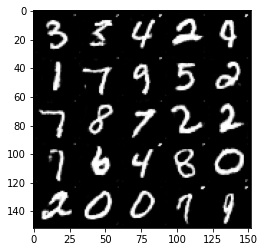

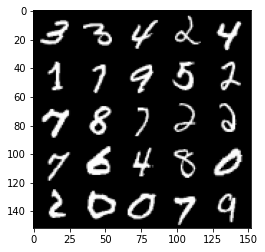

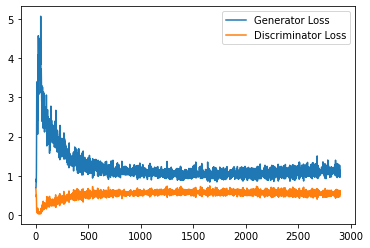

Epoch 124, step 58500: Generator loss: 1.166945438504219, discriminator loss: 0.5400316059589386


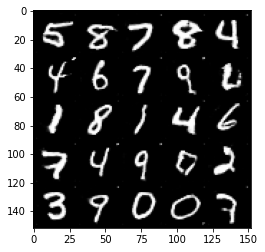

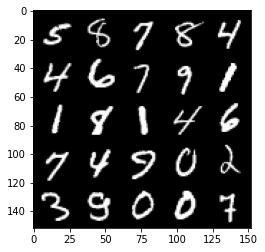

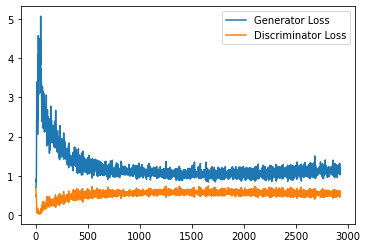

Epoch 125, step 59000: Generator loss: 1.1428604755401612, discriminator loss: 0.5480728327631951


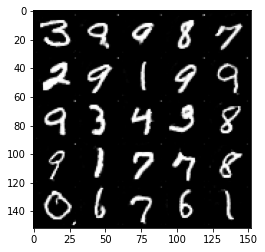

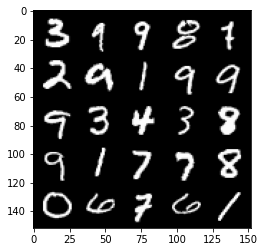

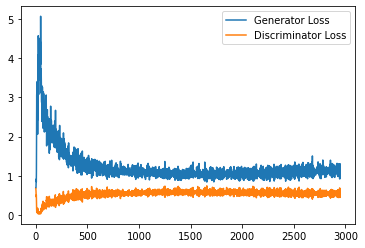

Epoch 126, step 59500: Generator loss: 1.130238344311714, discriminator loss: 0.544316964685917


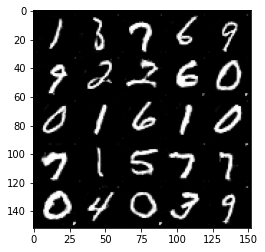

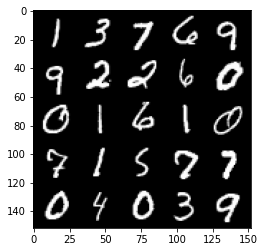

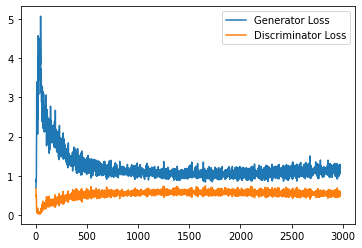

Epoch 127, step 60000: Generator loss: 1.1668647742271423, discriminator loss: 0.5420673002004623


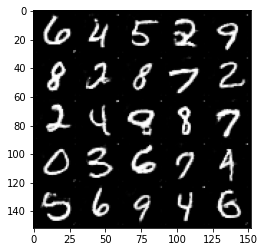

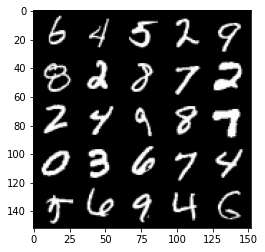

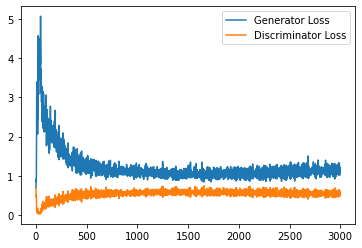

Epoch 128, step 60500: Generator loss: 1.1649673750400544, discriminator loss: 0.5414783620238304


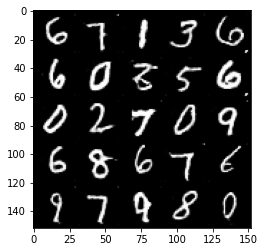

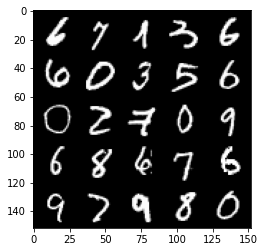

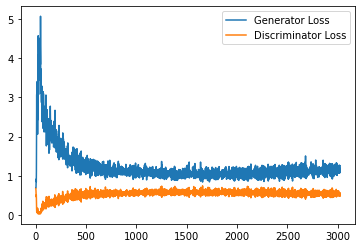

Epoch 130, step 61000: Generator loss: 1.1478344190120697, discriminator loss: 0.5480074651241302


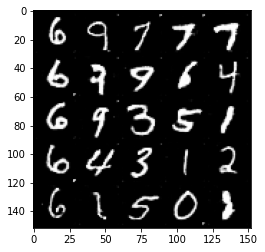

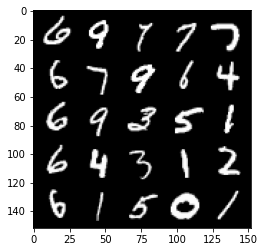

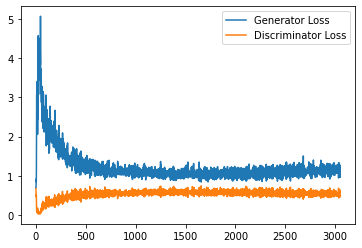

Epoch 131, step 61500: Generator loss: 1.1643396147489549, discriminator loss: 0.540912002325058


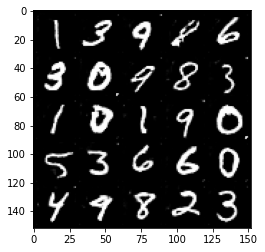

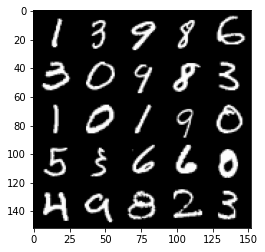

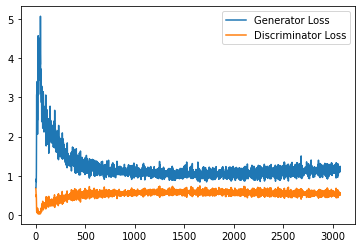

Epoch 132, step 62000: Generator loss: 1.1487051503658294, discriminator loss: 0.5426483621001243


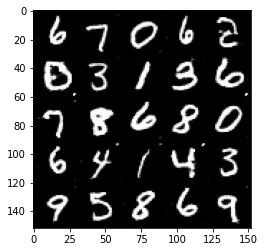

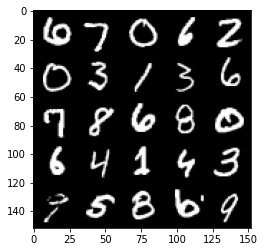

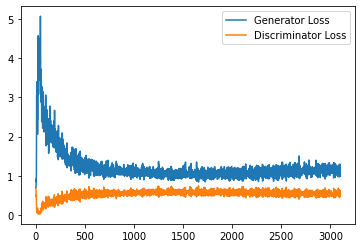

Epoch 133, step 62500: Generator loss: 1.1533615089654923, discriminator loss: 0.535540393948555


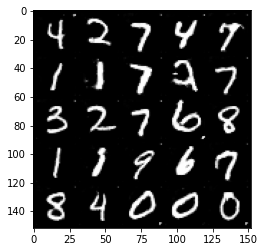

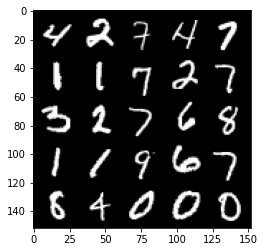

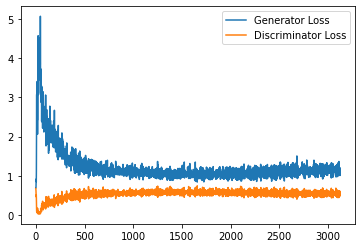

Epoch 134, step 63000: Generator loss: 1.1676587325334549, discriminator loss: 0.5365652323365212


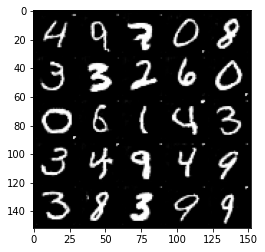

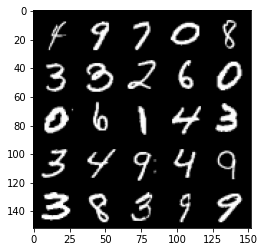

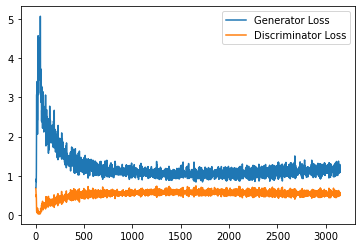

Epoch 135, step 63500: Generator loss: 1.1934101293087005, discriminator loss: 0.5347800227403641


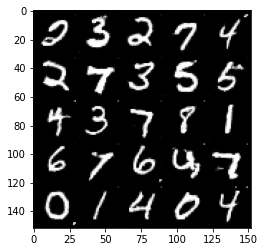

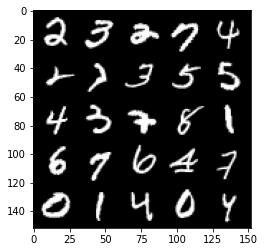

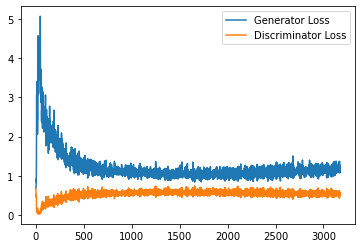

Epoch 136, step 64000: Generator loss: 1.1502622094154358, discriminator loss: 0.545982771039009


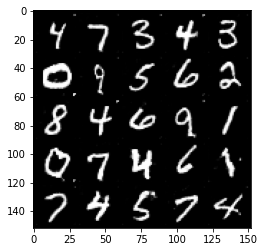

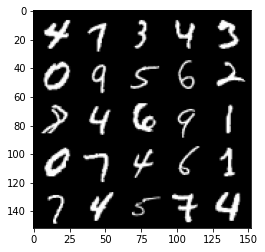

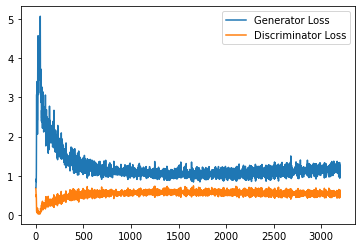

Epoch 137, step 64500: Generator loss: 1.1424297235012055, discriminator loss: 0.5336434293985367


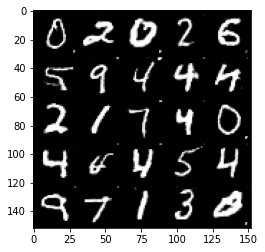

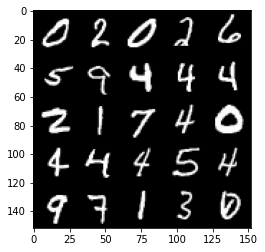

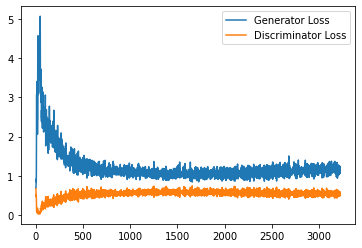

Epoch 138, step 65000: Generator loss: 1.19053145635128, discriminator loss: 0.5393337129950523


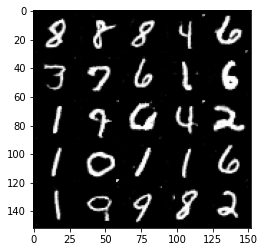

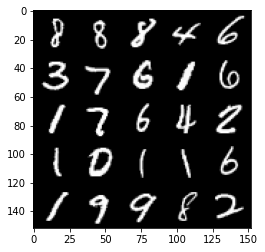

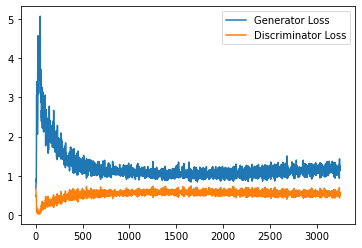

Epoch 139, step 65500: Generator loss: 1.1717681324481963, discriminator loss: 0.5364913973212242


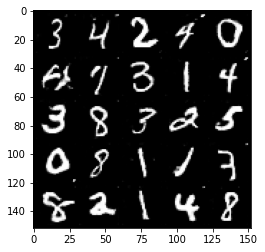

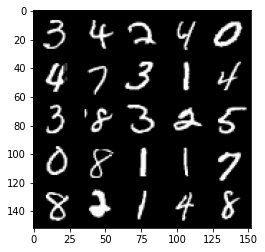

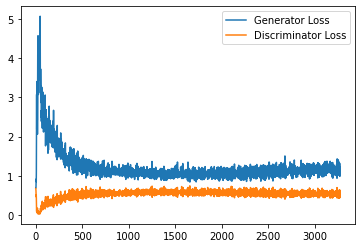

Epoch 140, step 66000: Generator loss: 1.18635107421875, discriminator loss: 0.5336636353135109


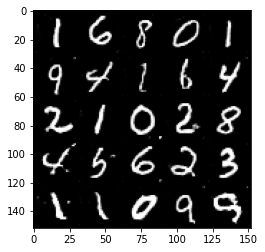

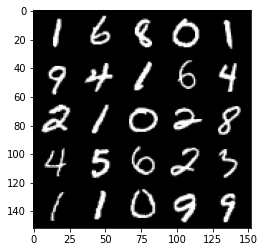

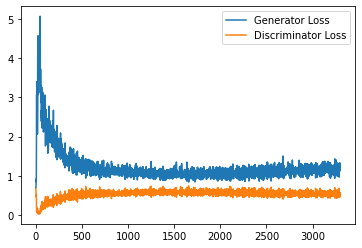

Epoch 141, step 66500: Generator loss: 1.2204624074697494, discriminator loss: 0.5322667196989059


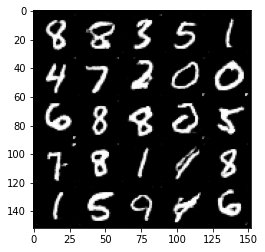

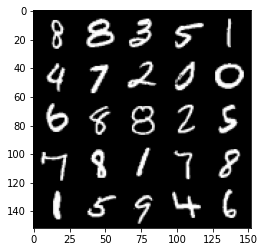

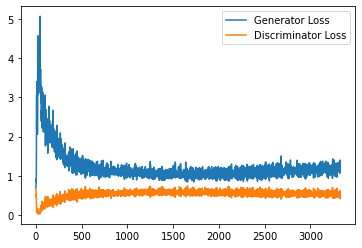

Epoch 142, step 67000: Generator loss: 1.1842419803142548, discriminator loss: 0.5376976423859596


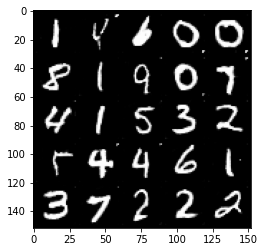

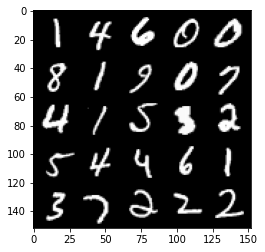

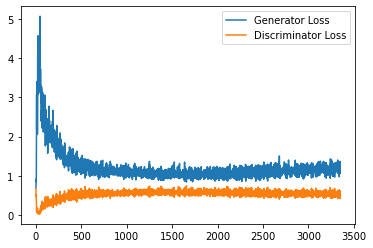

Epoch 143, step 67500: Generator loss: 1.1437179381847382, discriminator loss: 0.5296493120193482


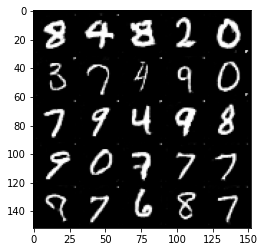

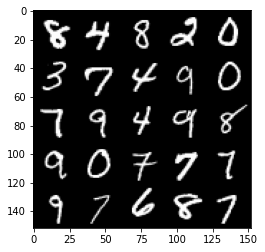

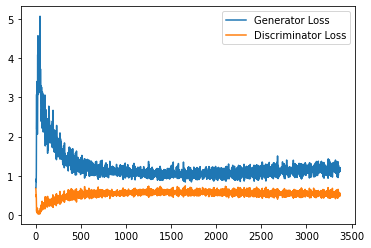

Epoch 144, step 68000: Generator loss: 1.1694236416816712, discriminator loss: 0.5368793914914132


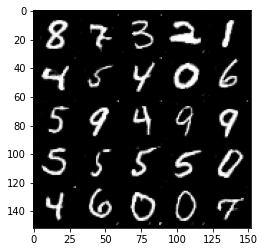

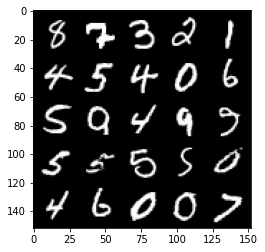

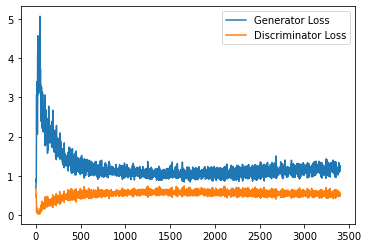

Epoch 146, step 68500: Generator loss: 1.1934868154525757, discriminator loss: 0.5319115743637085


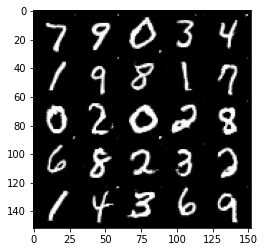

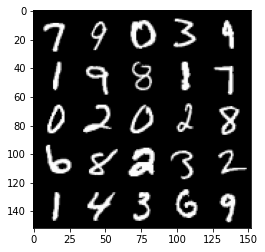

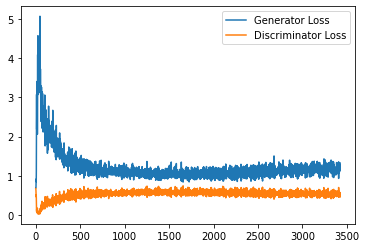

Epoch 147, step 69000: Generator loss: 1.1846587631702423, discriminator loss: 0.5340935689210892


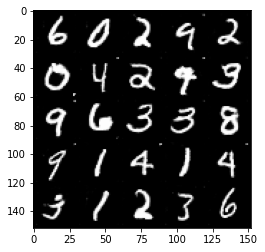

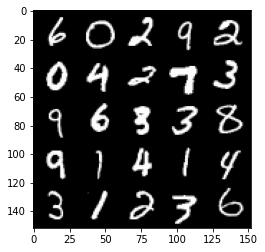

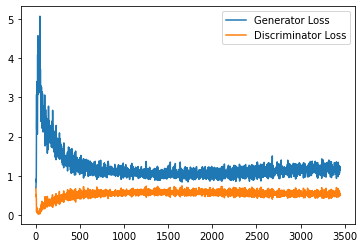

Epoch 148, step 69500: Generator loss: 1.1952714072465898, discriminator loss: 0.5293121112585067


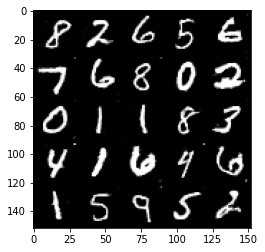

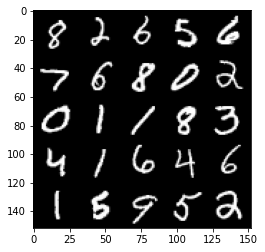

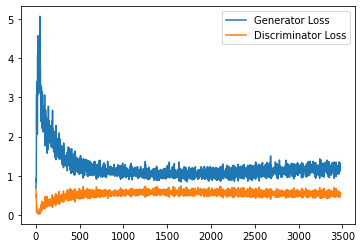

Epoch 149, step 70000: Generator loss: 1.2093060582876205, discriminator loss: 0.5225004671812058


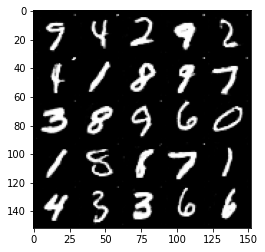

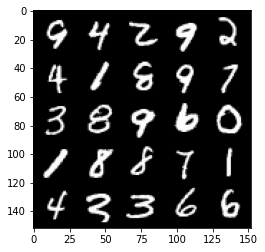

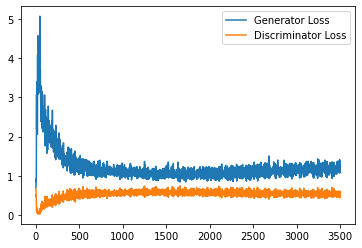

Epoch 150, step 70500: Generator loss: 1.1812226580381393, discriminator loss: 0.5314249425530434


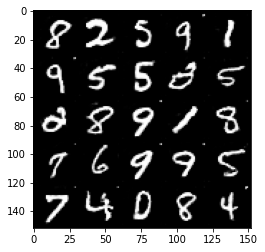

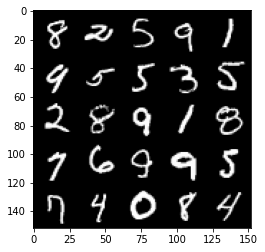

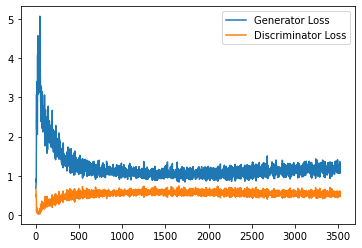

Epoch 151, step 71000: Generator loss: 1.1926555609703064, discriminator loss: 0.5345648539662361


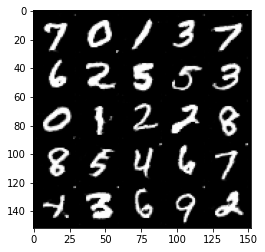

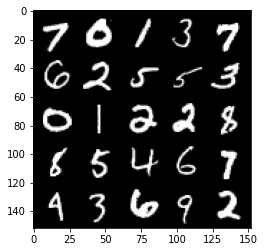

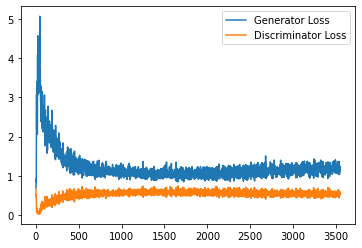

Epoch 152, step 71500: Generator loss: 1.2023958880901338, discriminator loss: 0.5330633753538132


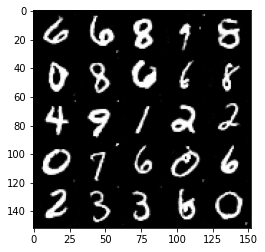

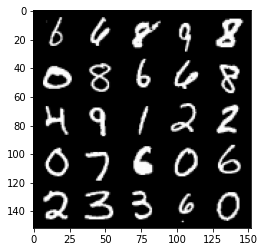

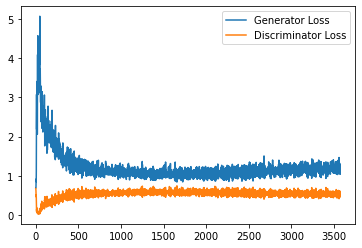

Epoch 153, step 72000: Generator loss: 1.18779793548584, discriminator loss: 0.5273407104611397


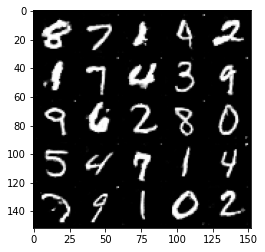

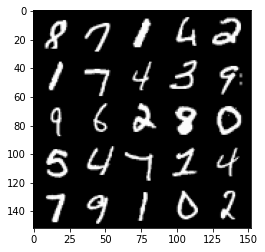

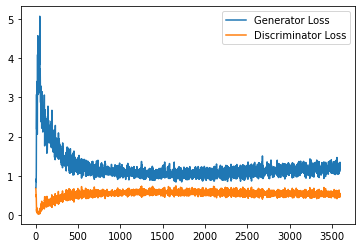

Epoch 154, step 72500: Generator loss: 1.2277513362169266, discriminator loss: 0.5296178240776062


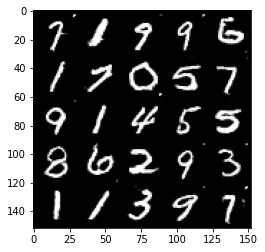

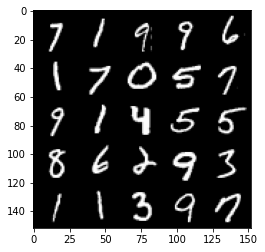

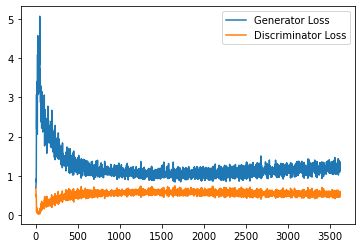

Epoch 155, step 73000: Generator loss: 1.2146648845672607, discriminator loss: 0.5317431927323342


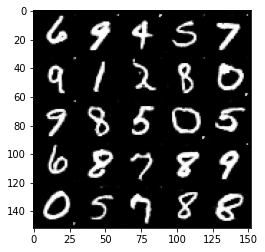

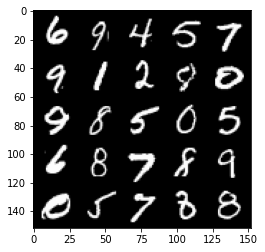

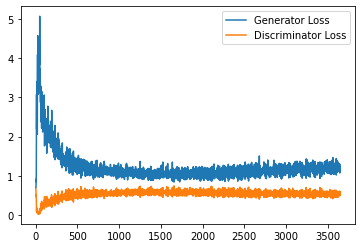

Epoch 156, step 73500: Generator loss: 1.213379139661789, discriminator loss: 0.5278502576947213


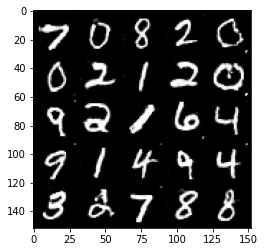

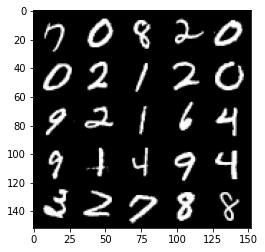

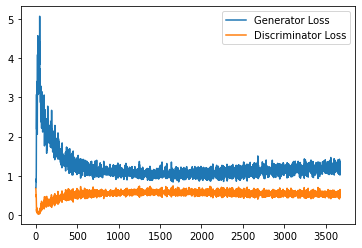

Epoch 157, step 74000: Generator loss: 1.1767398384809493, discriminator loss: 0.5258141398429871


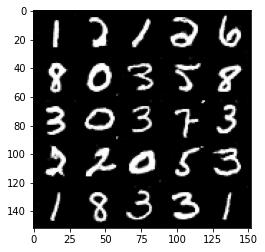

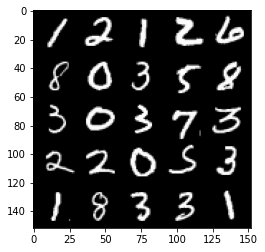

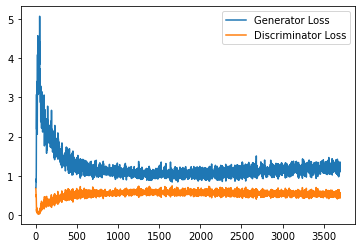

Epoch 158, step 74500: Generator loss: 1.2366535645723342, discriminator loss: 0.5222759847640991


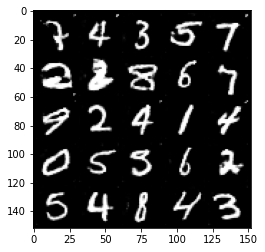

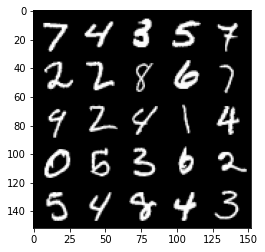

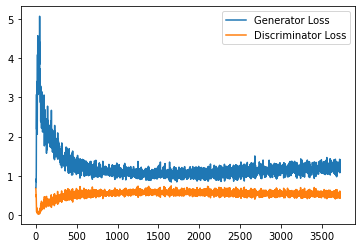

Epoch 159, step 75000: Generator loss: 1.2122064073085785, discriminator loss: 0.5291714194417


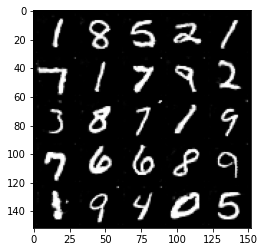

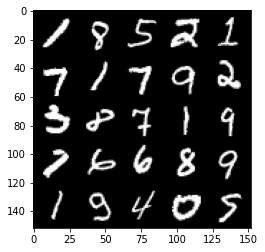

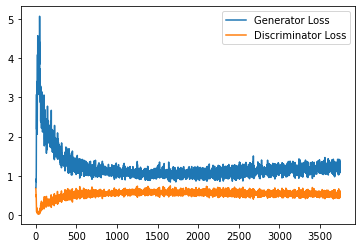

Epoch 160, step 75500: Generator loss: 1.2081186946630478, discriminator loss: 0.5270796002149581


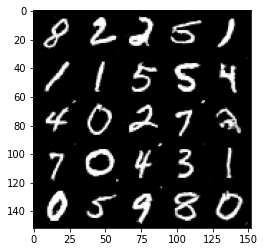

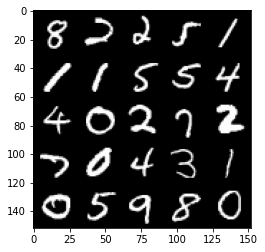

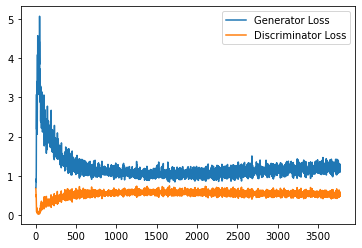

Epoch 162, step 76000: Generator loss: 1.2080103805065154, discriminator loss: 0.5273183755874634


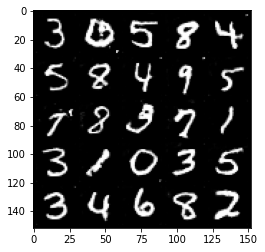

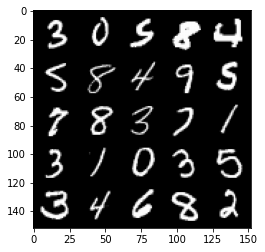

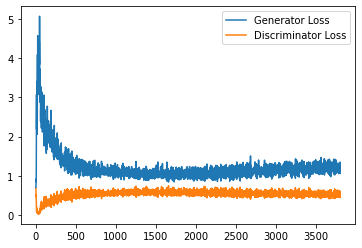

Epoch 163, step 76500: Generator loss: 1.2311260477304458, discriminator loss: 0.5164197658896447


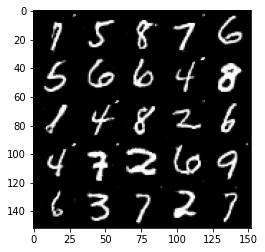

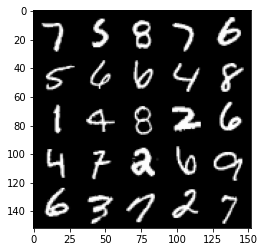

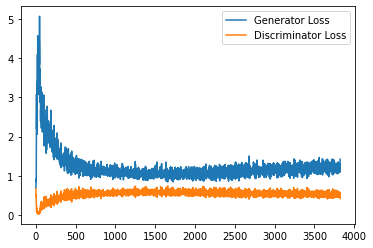

Epoch 164, step 77000: Generator loss: 1.2102574186325072, discriminator loss: 0.5311639624238014


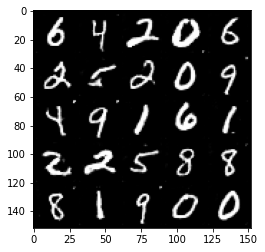

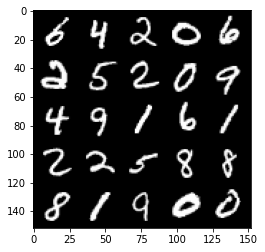

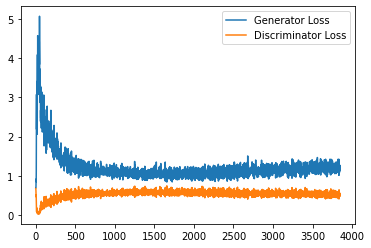

Epoch 165, step 77500: Generator loss: 1.2168046715259553, discriminator loss: 0.5171308454275131


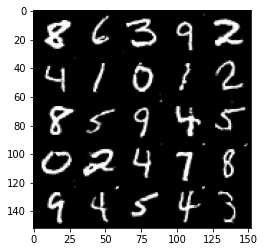

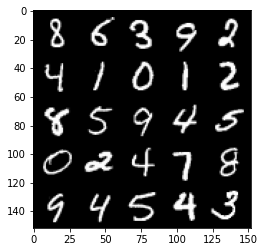

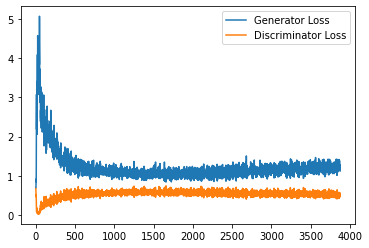

Epoch 166, step 78000: Generator loss: 1.2147471801042558, discriminator loss: 0.5313947132825851


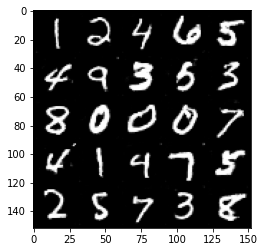

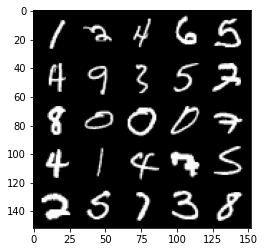

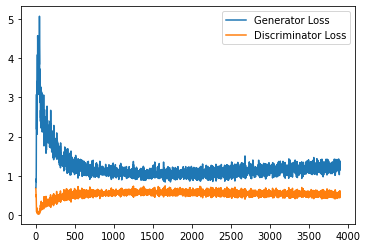

Epoch 167, step 78500: Generator loss: 1.212154573082924, discriminator loss: 0.5324686620235443


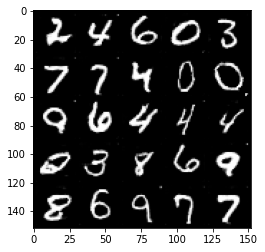

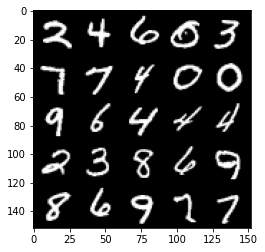

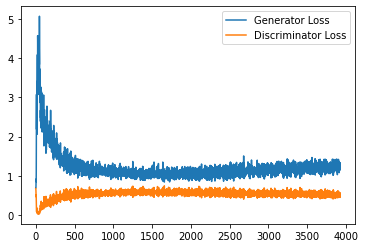

Epoch 168, step 79000: Generator loss: 1.1865456564426422, discriminator loss: 0.5290204991698265


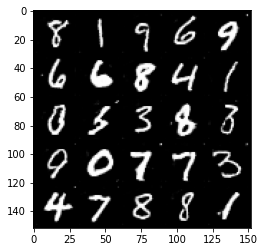

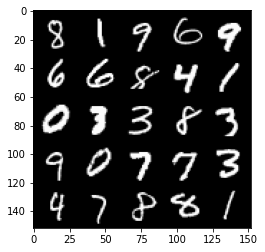

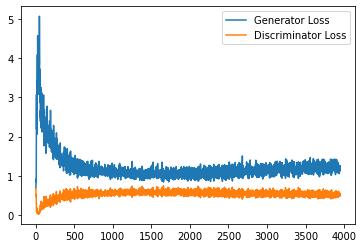

Epoch 169, step 79500: Generator loss: 1.1952220058441163, discriminator loss: 0.5325374548435211


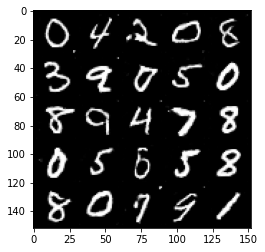

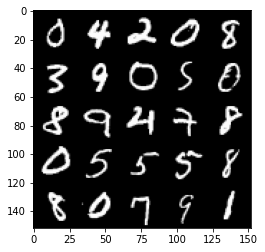

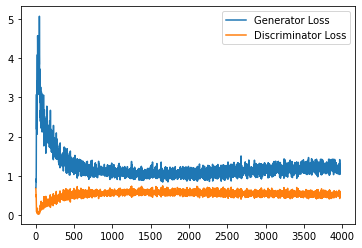

Epoch 170, step 80000: Generator loss: 1.197293437242508, discriminator loss: 0.5254319143295288


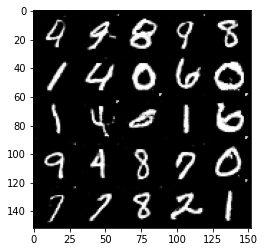

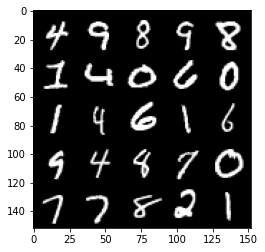

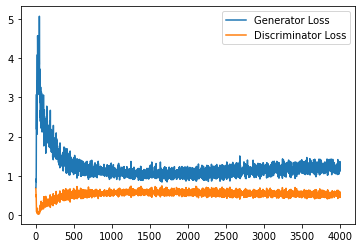

Epoch 171, step 80500: Generator loss: 1.2381666967868805, discriminator loss: 0.5234042474627495


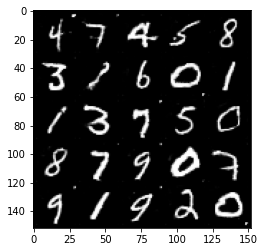

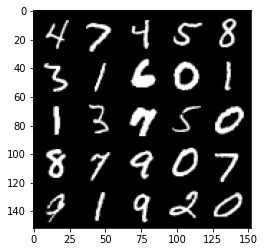

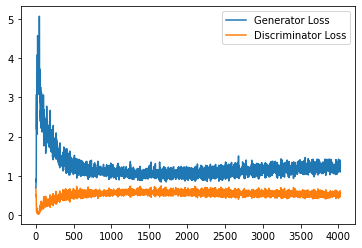

Epoch 172, step 81000: Generator loss: 1.20647308075428, discriminator loss: 0.529046986401081


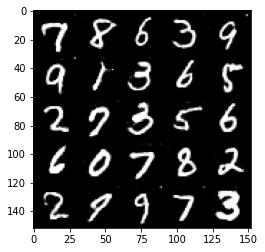

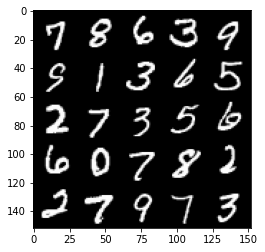

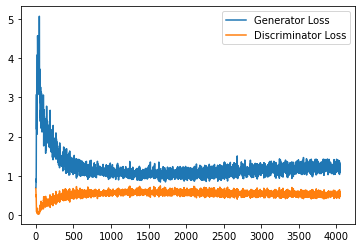

Epoch 173, step 81500: Generator loss: 1.2419199333190918, discriminator loss: 0.5265694115757942


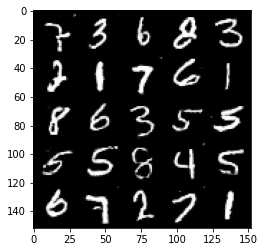

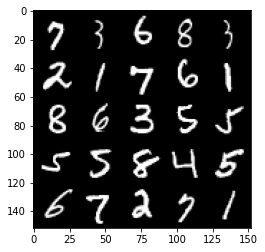

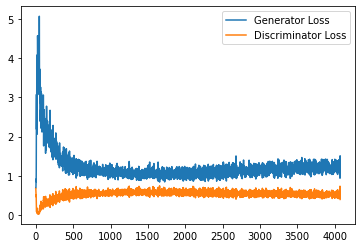

Epoch 174, step 82000: Generator loss: 1.2116905655860901, discriminator loss: 0.528047899544239


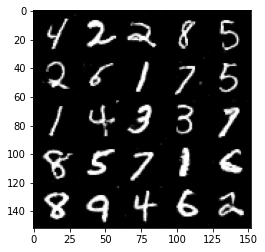

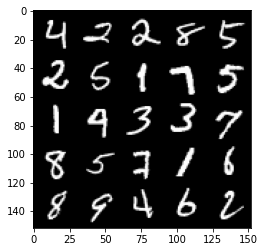

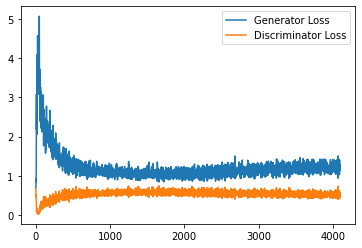

Epoch 175, step 82500: Generator loss: 1.2515707141160965, discriminator loss: 0.5196733338832855


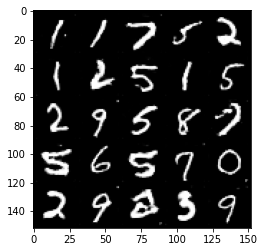

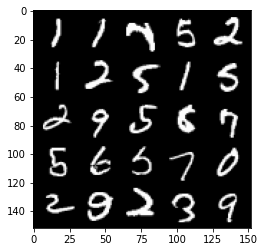

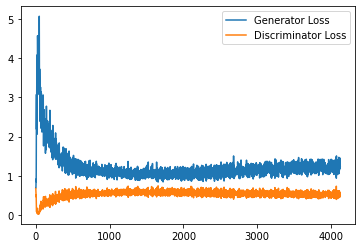

Epoch 176, step 83000: Generator loss: 1.2147665642499923, discriminator loss: 0.5284982314705848


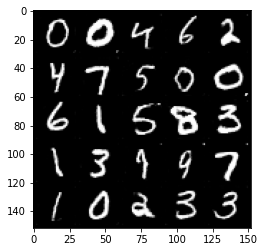

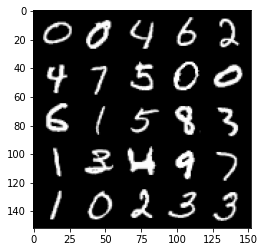

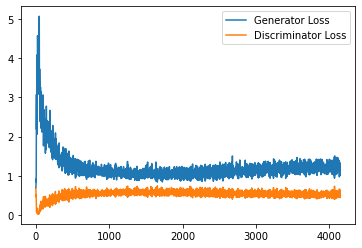

Epoch 178, step 83500: Generator loss: 1.2335716544389725, discriminator loss: 0.5248176161050796


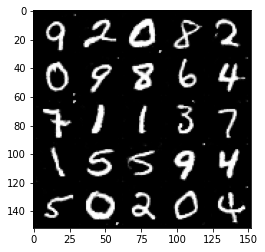

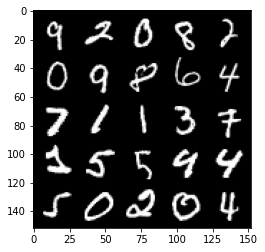

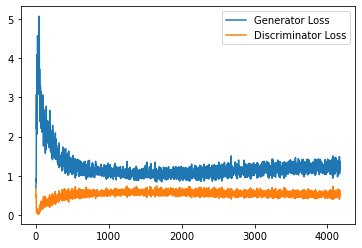

Epoch 179, step 84000: Generator loss: 1.2080891394615174, discriminator loss: 0.5214115409851074


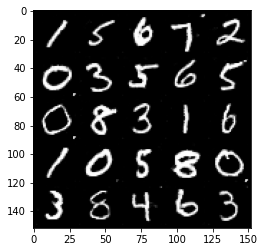

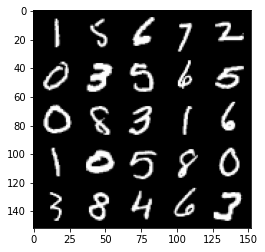

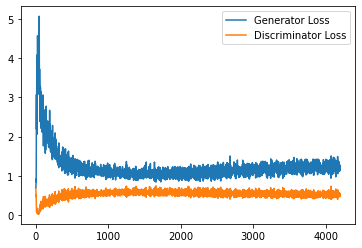

Epoch 180, step 84500: Generator loss: 1.223087633728981, discriminator loss: 0.5211136198043823


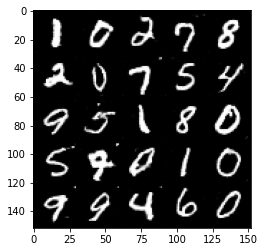

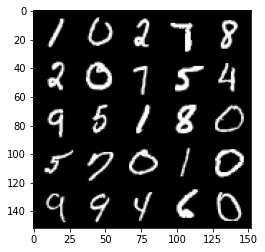

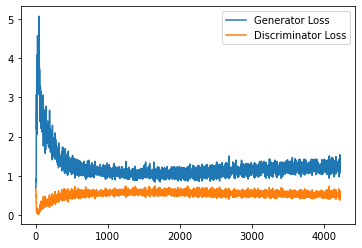

Epoch 181, step 85000: Generator loss: 1.2341252757310868, discriminator loss: 0.5241795003414154


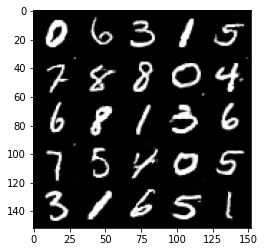

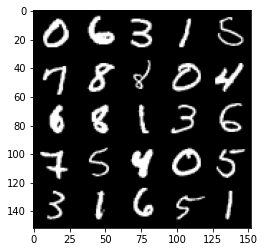

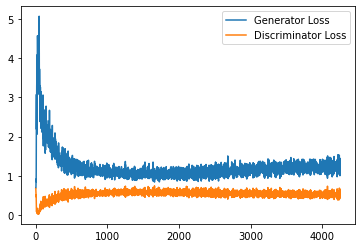

Epoch 182, step 85500: Generator loss: 1.235277094244957, discriminator loss: 0.5199667926430702


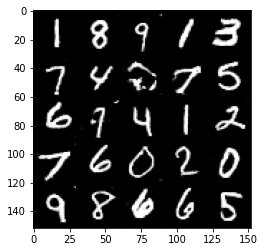

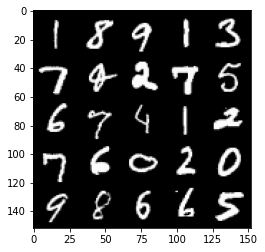

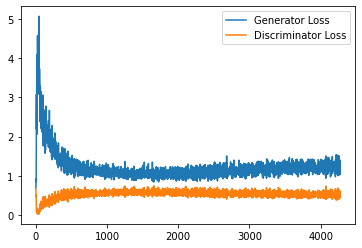

Epoch 183, step 86000: Generator loss: 1.2551002243757248, discriminator loss: 0.5204159197211266


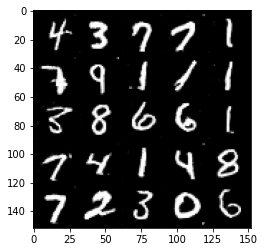

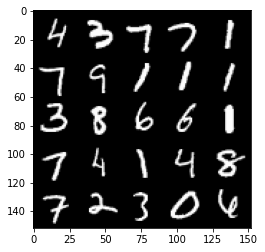

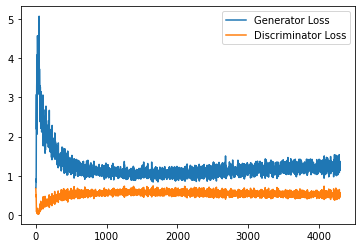

Epoch 184, step 86500: Generator loss: 1.2577416795492171, discriminator loss: 0.5188072792887688


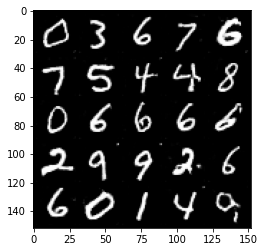

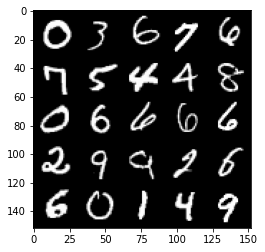

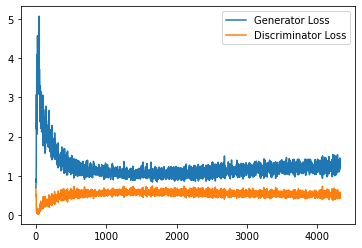

Epoch 185, step 87000: Generator loss: 1.2137044637203216, discriminator loss: 0.5270541987419128


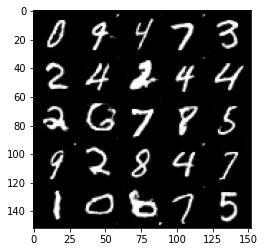

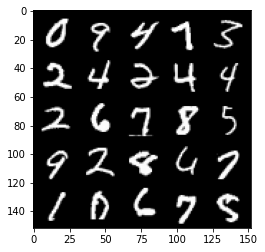

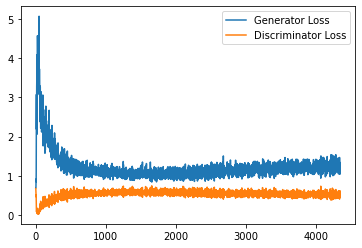

Epoch 186, step 87500: Generator loss: 1.2440754417181015, discriminator loss: 0.5240174723267556


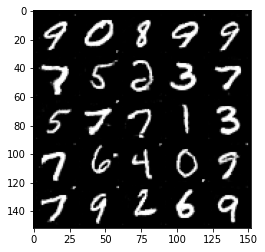

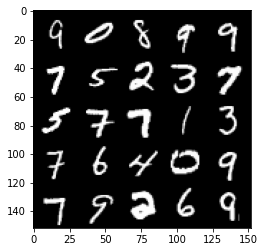

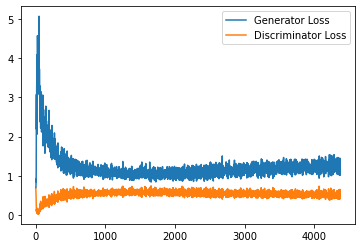

Epoch 187, step 88000: Generator loss: 1.2454922497272491, discriminator loss: 0.5177849907875061


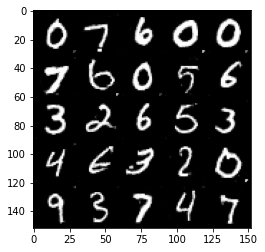

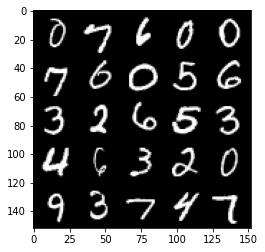

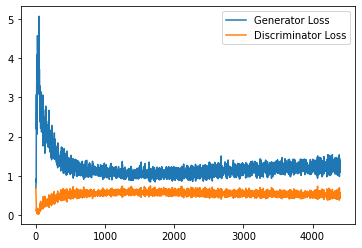

Epoch 188, step 88500: Generator loss: 1.2656804704666138, discriminator loss: 0.520232546210289


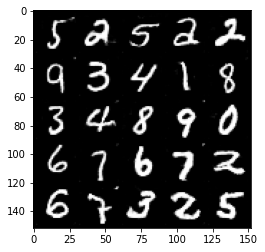

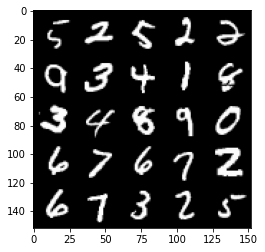

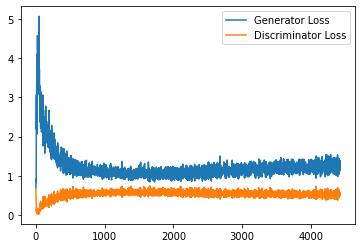

Epoch 189, step 89000: Generator loss: 1.2269699807167054, discriminator loss: 0.5150997943878174


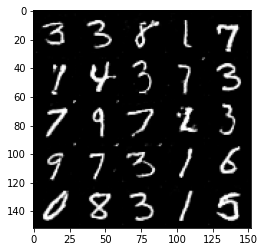

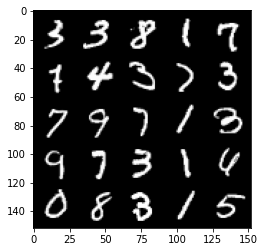

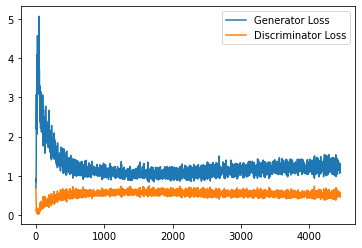

Epoch 190, step 89500: Generator loss: 1.2128316711187364, discriminator loss: 0.5257561419606209


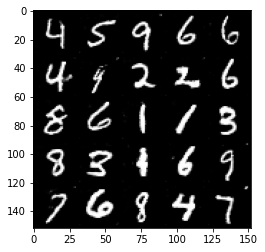

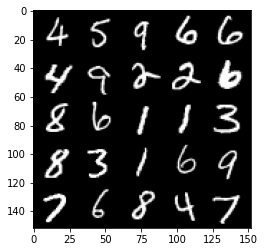

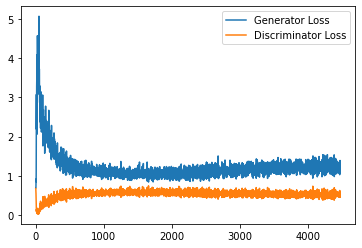

Epoch 191, step 90000: Generator loss: 1.2668469718694686, discriminator loss: 0.5180489162802696


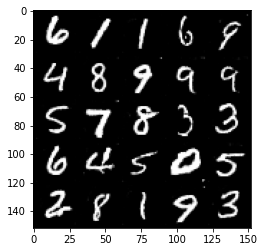

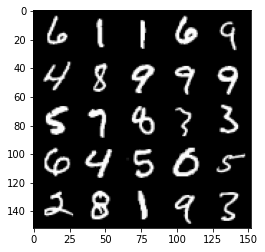

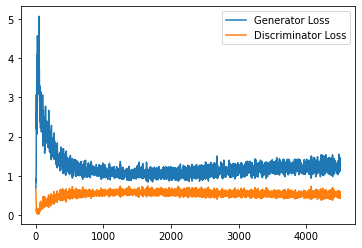

Epoch 192, step 90500: Generator loss: 1.2632672832012177, discriminator loss: 0.5180901748538017


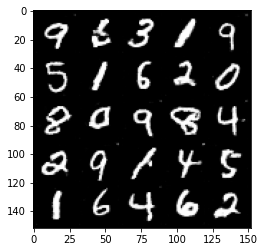

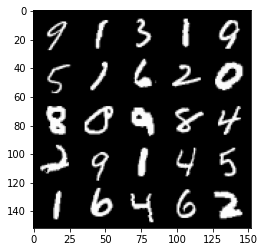

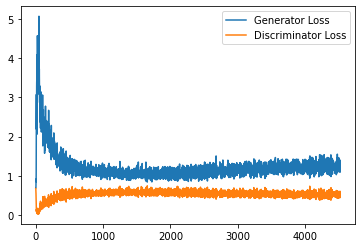

Epoch 194, step 91000: Generator loss: 1.2764941484928132, discriminator loss: 0.514520969092846


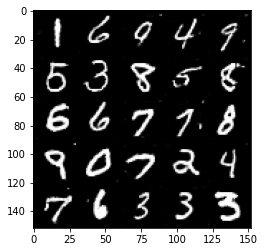

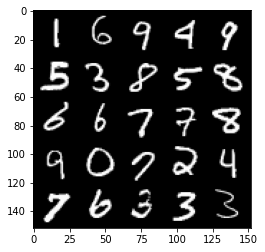

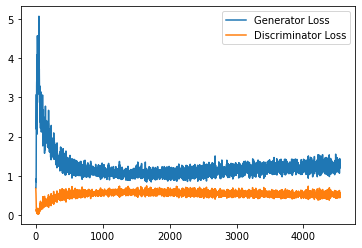

Epoch 195, step 91500: Generator loss: 1.2346895490884782, discriminator loss: 0.525261474609375


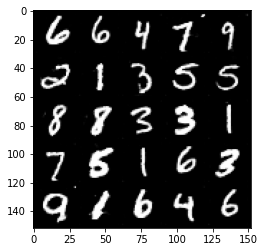

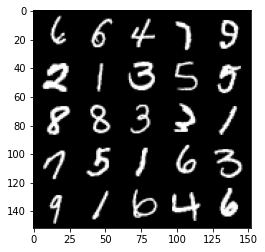

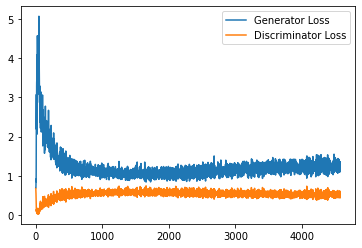

Epoch 196, step 92000: Generator loss: 1.235038074016571, discriminator loss: 0.5291328701376915


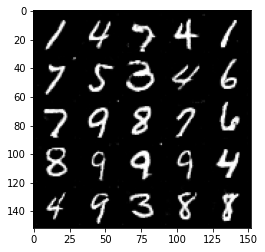

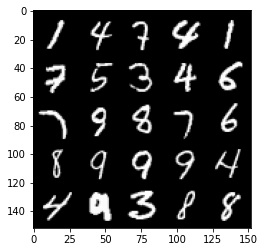

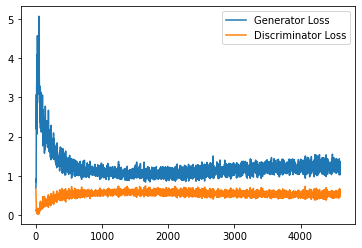

Epoch 197, step 92500: Generator loss: 1.2514285026788712, discriminator loss: 0.5165064234733582


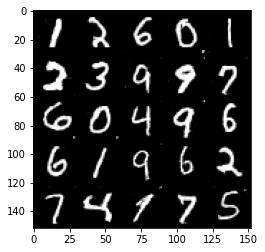

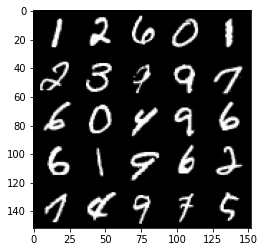

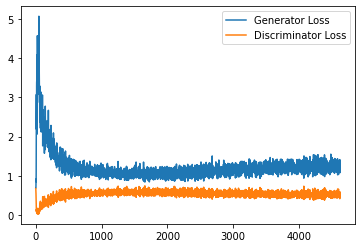

Epoch 198, step 93000: Generator loss: 1.2404599891901016, discriminator loss: 0.5256021281480789


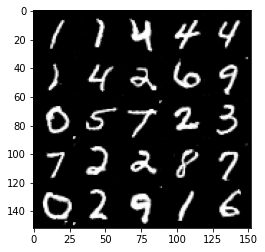

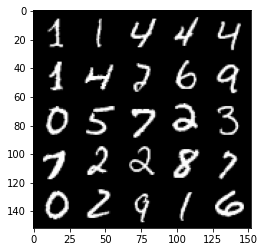

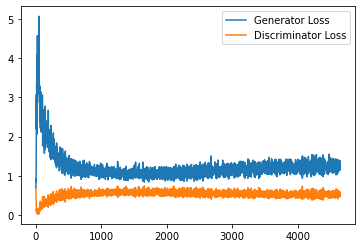

Epoch 199, step 93500: Generator loss: 1.2375280504226684, discriminator loss: 0.5256149606108665


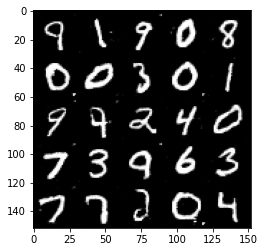

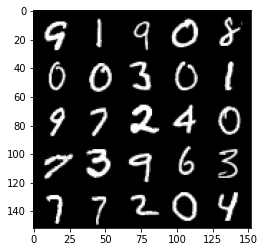

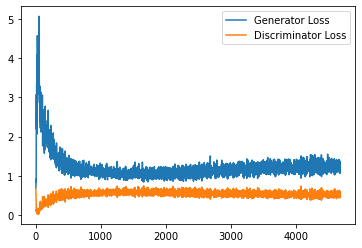

In [17]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        #noise_and_labels = None
        #fake = None
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels.detach())
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        #fake_image_and_labels = None
        #real_image_and_labels = None
        #disc_fake_pred = None
        #disc_real_pred = None
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [18]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

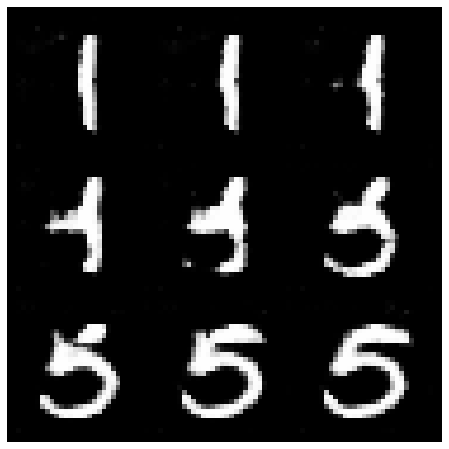

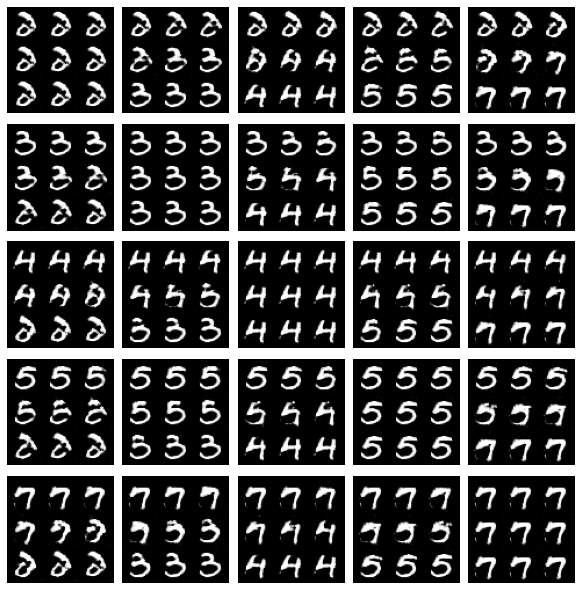

In [22]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

## Uncomment the following lines of code if you would like to visualize a set of pairwise class 
## interpolations for a collection of different numbers, all in a single grid of interpolations.
## You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

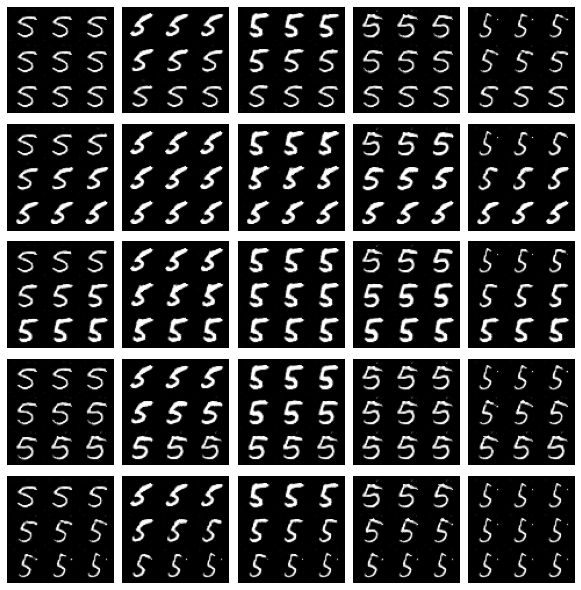

In [23]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()